# Problem Statement and Background

## Introduction

### Problem Statement

The purpose of this capstone project is to compare the locations within Chicago to see which Zip Code is best suited to attract tourists/locals for a food crawl event meant to showcase the City's diversity.

### Background

Chicago is known to have a diverse population. It is a city that attracts millions of people every year for its art, entertainment, and food. Tourists and locals are attracted to the city for major events such as the Taste of Chicago and Lollapalooza as well as the art installments around the city such as the Cloud Gate in Millenium Park or the Picasso on Daley Plaza. To top it all off, with such a diverse population and it's location, Chicago has become a hub for all sorts of cuisines and beverages. On the food and drinks front, over the years, Chicago has been trying to keep its traffic alive at night with bar crawls and pop up bars but only seldom have they shifted focused on a food crawl. Festivals have been one way to get food and drink vendors to promote their businesses but seldom has there been an event where the attraction for a festival was the food or drink location. As a part of the City's goal to promote diversity, bring in more visitors, and help stimulate the food and drink business, holding a food crawl festival where there are diverse cuisines and some drink locations to give visitors a break from eating would help. This would provide for a great social event where visitors can tour the city's architecture, listen to the talented musical artists, and immerse themselves in the art. Currently, with the pandemic, this is a battle and getting approval to carry out such an event would require proper safety and the right permits as well as time. Given the timeframe, finding the right location within the city through data analysis and then alloting enough time for the marketing campaign is essential to contributing to the city's primary goals.


### Data Description

In order to pinpoint where this food crawl festival can be held, food and drink venues associated with the Zip Codes within Chicago need to be searched. Then from there, the data would need to be minimized to focus on the top 10 Zip Codes to get a better picture as to how the planning committee wants to proceed based on their main decision factors. The main factors for choosing a location for the food crawl will be based on the number of diverse cuisines, some diverse drink locations, and an area that allows for some form of entertainment or art in between the food crawl locations. Locations must be within a decent proximity of eachother.



### Data Method

Taking the known Zip Codes and searching Foursquare for all sorts of venues, gives a large list of locations as well as their categories. Since the focus is on food and drinks, this list was minimized to only focus on those rows. From there, 





In [1]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

#!conda install -c conda-forge geopy --yes # uncomment this line if you haven't completed the Foursquare API lab
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

#!conda install -c conda-forge folium=0.5.0 --yes # uncomment this line if you haven't completed the Foursquare API lab
import folium # map rendering library

print('Libraries imported.')

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\getlimits.py:174: RuntimeWarning: divide by zero encountered in exp2
  eps=exp2(ld(-112)),
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\getlimits.py:53: RuntimeWarning: divide by zero encountered in log10
  self.precision = int(-log10(self.eps))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\getlimits.py:54: RuntimeWarning: divide by zero encountered in power
  self.resolution = float_to_float(float_conv(10) ** (-self.precision))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\getlimits.py:186: RuntimeWarning: divide by zero encountered in exp2
  epsneg_f80 = exp2(ld(-64))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\getlimits.py:187: RuntimeWarning: divide by zero encountered in exp2
  tiny_f80 = exp2(ld(-16382))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\getlimits.py:201: RuntimeWarning: divide by zero encountered in exp2
  eps=exp2(ld(-63)),
C:\Users\Reena\anaconda3\lib\site-packages\nump

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\function_base.py:129: RuntimeWarning: divide by zero encountered in multiply
  start = asanyarray(start) * 1.0
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\function_base.py:130: RuntimeWarning: divide by zero encountered in multiply
  stop  = asanyarray(stop)  * 1.0
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\function_base.py:136: RuntimeWarning: divide by zero encountered in double_scalars
  delta = stop - start
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\function_base.py:143: RuntimeWarning: divide by zero encountered in double_scalars
  step = delta / div
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\function_base.py:153: RuntimeWarning: divide by zero encountered in multiply
  y *= step
C:\Users\Reena\anaconda3\lib\site-pack

Libraries imported.


# Let's take a look at Chicago

In [4]:
Codes = []
Codes = '60601 60602 60603 60604 60605 60606 60607 60608 60609 60610 60611 60612 60613 60614 60615 60616 60617 60618 60619 60620 60621 60622 60623 60624 60625 60626 60628 60629 60630 60631 60632 60633 60634 60636 60637 60638 60639 60640 60641 60642 60643 60644 60645 60646 60647 60649 60651 60652 60653 60654 60655 60656 60657 60659 60660 60661 60664 60666 60668 60669 60670 60673 60674 60675 60677 60678 60680 60681 60682 60684 60685 60686 60687 60688 60689 60690 60691 60693 60694 60695 60696 60697 60699 60701'
Codes = Codes.split()
print(Codes)

# Calling DataFrame constructor on list 
# with indices and columns specified 
Chicago = pd.DataFrame(Codes, columns =['Postal Code'])
Chicago['Address'] = 'Chicago, IL'
Chicago 

['60601', '60602', '60603', '60604', '60605', '60606', '60607', '60608', '60609', '60610', '60611', '60612', '60613', '60614', '60615', '60616', '60617', '60618', '60619', '60620', '60621', '60622', '60623', '60624', '60625', '60626', '60628', '60629', '60630', '60631', '60632', '60633', '60634', '60636', '60637', '60638', '60639', '60640', '60641', '60642', '60643', '60644', '60645', '60646', '60647', '60649', '60651', '60652', '60653', '60654', '60655', '60656', '60657', '60659', '60660', '60661', '60664', '60666', '60668', '60669', '60670', '60673', '60674', '60675', '60677', '60678', '60680', '60681', '60682', '60684', '60685', '60686', '60687', '60688', '60689', '60690', '60691', '60693', '60694', '60695', '60696', '60697', '60699', '60701']


C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:226: RuntimeWarning: divide by zero encountered in equal
  if (new_blknos == -1).any():
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:379: RuntimeWarning: divide by zero encountered in invert
  return ~res
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1252: RuntimeWarning: divide by zero encountered in bitwise_and
  is_float_type = lib.map_infer(vals, is_float) & notna(vals)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:30: RuntimeWarning: divide by zero encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:878: RuntimeWarning: divide by zero encountered in long_scala

,Postal Code,Address
0,60601,"Chicago, IL"
1,60602,"Chicago, IL"
2,60603,"Chicago, IL"
3,60604,"Chicago, IL"
4,60605,"Chicago, IL"
5,60606,"Chicago, IL"
6,60607,"Chicago, IL"
7,60608,"Chicago, IL"
8,60609,"Chicago, IL"
9,60610,"Chicago, IL"


In [5]:
#Lets get the latitude and Longitude of the Postal Codes.
#Find Latitude and Longitude for New York and then later plot the locations within df_NYCodes with folium.

from geopy.geocoders import Nominatim

Chicago['Postal Code'] = Chicago['Postal Code'].astype(str)

for index, row in Chicago.iterrows():
    
    address = row['Address'] + ' ' + row['Postal Code'] #Don't have the neighborhood or borough information so we will work with what we got.
    geolocator = Nominatim(user_agent="explorer", timeout = 30) #Need to specify timeout time because Nominatim kept quitting after 2 - 4 addresses as it was too many requests. The timeout allows Nominatim to search, pull, and then try again for the next Postal Code after a break.
    location = geolocator.geocode(address)
    latitude = location.latitude
    longitude = location.longitude
    Chicago.loc[index, 'Latitude'] = latitude
    Chicago.loc[index, 'Longitude'] = longitude
    print('The geograpical coordinate of {} are {}, {}.'.format(address, latitude, longitude))
    
    
print('Latitude and Longitude for each Postal Code has been added.')

print(Chicago)

C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:226: RuntimeWarning: divide by zero encountered in equal
  if (new_blknos == -1).any():


The geograpical coordinate of Chicago, IL 60601 are 41.88594885340364, -87.62426448252586.
The geograpical coordinate of Chicago, IL 60602 are 41.8829932140056, -87.6292514194862.
The geograpical coordinate of Chicago, IL 60603 are 41.8809250171685, -87.62817634467322.
The geograpical coordinate of Chicago, IL 60604 are 41.878283633709934, -87.62800983748329.
The geograpical coordinate of Chicago, IL 60605 are 41.8659983, -87.6082237.
The geograpical coordinate of Chicago, IL 60606 are 41.88305262146516, -87.63660835899044.
The geograpical coordinate of Chicago, IL 60607 are 41.8883951, -87.652206.
The geograpical coordinate of Chicago, IL 60608 are 41.8626357, -87.6687915.
The geograpical coordinate of Chicago, IL 60609 are 41.8249226, -87.6381346.
The geograpical coordinate of Chicago, IL 60610 are 41.8884984, -87.6292815.
The geograpical coordinate of Chicago, IL 60611 are 41.9013755, -87.623854.
The geograpical coordinate of Chicago, IL 60612 are 41.890555, -87.687272.
The geograpi

AttributeError: 'NoneType' object has no attribute 'latitude'

In [6]:
#Removing any zip codes that don't have a latitude between 41 - 43. Couldn't look at 29 other postal codes as we reached a limit so that it.
index = Chicago[Chicago['Latitude'] > 43].index
Chicago.drop(index, inplace=True)

index = Chicago[Chicago['Latitude'] < 41].index
Chicago.drop(index, inplace=True)

Chicago = Chicago.dropna()

Chicago

C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:205: RuntimeWarning: divide by zero encountered in less
  mask = indices < 0
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in greater_equal
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in less
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in bitwise_or
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:1389: RuntimeWarning: divide by zero encountered in equal
  if ((indexer == -1) | (indexer >= n)).any():
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:1389: RuntimeWarning: divide by zero encountered in greater_equal
  if ((indexer == -1) | (in

,Postal Code,Address,Latitude,Longitude
0,60601,"Chicago, IL",41.885949,-87.624264
1,60602,"Chicago, IL",41.882993,-87.629251
2,60603,"Chicago, IL",41.880925,-87.628176
3,60604,"Chicago, IL",41.878284,-87.628010
4,60605,"Chicago, IL",41.865998,-87.608224
5,60606,"Chicago, IL",41.883053,-87.636608
6,60607,"Chicago, IL",41.888395,-87.652206
7,60608,"Chicago, IL",41.862636,-87.668791
8,60609,"Chicago, IL",41.824923,-87.638135
9,60610,"Chicago, IL",41.888498,-87.629282


In [69]:
# Here are the credentials for Foursquare

CLIENT_ID = 'Hidden' # your Foursquare ID
CLIENT_SECRET = 'Hidden' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version
LIMIT = 100 # A default Foursquare API limit value

print('Your credentials:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentials:
CLIENT_ID: Hidden
CLIENT_SECRET:Hidden


In [8]:
# The following function retrieves the venues given the names and coordinates and stores it into dataframe.
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    Chicago_venues=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # Send the GET request and examine the results.
        import requests #Need to do this so that the requests function works.
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        
        
        # return only relevant information for each nearby venue
        Chicago_venues.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],
            v['venue']['categories'][0]['name']) for v in results])

    nearby_Chicagovenues = pd.DataFrame([item for Chicago_venues in Chicago_venues for item in Chicago_venues])
    nearby_Chicagovenues.columns = ['Neighbourhood', 
                  'Neighborhood_Latitude', 
                  'Neighborhood_Longitude', 
                  'Venue', 
                  'Venue_Latitude', 
                  'Venue_Longitude',
                  'Venue_Category']
    
    return(nearby_Chicagovenues)

In [9]:
Chi_venues = getNearbyVenues(names=Chicago['Postal Code'], latitudes=Chicago['Latitude'], longitudes=Chicago['Longitude'])
# Lets see what the size of the data frame is.
print(Chi_venues.shape)
Chi_venues

60601
60602
60603
60604
60605
60606
60607
60608
60609
60610
60611
60612
60613
60614
60615
60616
60617
60618
60619
60620
60621
60622
60623
60624
60625
60626
60628
60629
60630
60631
60632
60633
60634
60636
60637
60638
60639
60640
60641
60642
60643
60644
60645
60646
60647
60649
60651
60652
60653
60654
60655
60656
60657
60659
60660
60661
60664
60666
60668


C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:226: RuntimeWarning: divide by zero encountered in equal
  if (new_blknos == -1).any():
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)


(1975, 7)


C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:379: RuntimeWarning: divide by zero encountered in invert
  return ~res
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1252: RuntimeWarning: divide by zero encountered in bitwise_and
  is_float_type = lib.map_infer(vals, is_float) & notna(vals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan
  result = np.isnan(values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1375: RuntimeWarning: divide by zero encountered in invert
  imask = (~mask).ravel()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1418: RuntimeWarning: divide by zero encountered in absolute
  abs_vals = np.abs(self.values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1422: RuntimeWarning: divide by zero encountered in greater
  has_large_values = (abs_vals > 1e6).any()
C:\U

,Neighbourhood,Neighborhood_Latitude,Neighborhood_Longitude,Venue,Venue_Latitude,Venue_Longitude,Venue_Category
0,60601,41.885949,-87.624264,sweetgreen,41.884964,-87.624728,Salad Place
1,60601,41.885949,-87.624264,Roti Modern Mediterranean,41.886048,-87.624948,Mediterranean Restaurant
2,60601,41.885949,-87.624264,Virgin Hotels Chicago,41.886065,-87.625853,Hotel
3,60601,41.885949,-87.624264,Chicago Architecture Center,41.887720,-87.623650,Tour Provider
4,60601,41.885949,-87.624264,Wildberry Pancakes & Cafe,41.884412,-87.623047,Breakfast Spot
5,60601,41.885949,-87.624264,Intelligentsia Coffee,41.884517,-87.625783,Coffee Shop
6,60601,41.885949,-87.624264,St. Jane Chicago,41.886573,-87.624902,Hotel
7,60601,41.885949,-87.624264,"LondonHouse Chicago, Curio Collection by Hilton",41.887832,-87.625426,Hotel
8,60601,41.885949,-87.624264,The Chicago Theatre,41.885539,-87.627151,Theater
9,60601,41.885949,-87.624264,Giordano's,41.885130,-87.623761,Pizza Place


In [10]:
#Look for all places where the string in Venue_Category contains Restaurant, Joint, and Place.

Places =['Bar', 'Bakery', 'Pub', 'Bagel', 'Salad', 'Sandwich', 'Food', 'Steakhouse', 'Donut', 'Dessert', 'Brewery', 'Buffet', 'Deli', 'Cafe', 'Coffee', 'Cafeteria', 'Restaurant', 'Joint', 'Place']

def matcher(x):
    for i in Places:
        if i.lower() in x.lower():
            return i
    else:
        return np.nan

Chi_venues['Cuisine_Beverage'] = Chi_venues['Venue_Category'].apply(matcher)

Chi_venues

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:379: RuntimeWarning: divide by zero encountered in invert
  return ~res
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1252: RuntimeWarning: divide by zero encountered in bitwise_and
  is_float_type = lib.map_infer(vals, is_float) & notna(vals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan
  result = np.isnan(values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1375: RuntimeWarning: divide by zero encountered in invert
  imask = (~mask).ravel()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1418: RuntimeWarning: divide by zero encountered in absolute
  abs_vals = np.abs(self.values)
C:\Users

,Neighbourhood,Neighborhood_Latitude,Neighborhood_Longitude,Venue,Venue_Latitude,Venue_Longitude,Venue_Category,Cuisine_Beverage
0,60601,41.885949,-87.624264,sweetgreen,41.884964,-87.624728,Salad Place,Salad
1,60601,41.885949,-87.624264,Roti Modern Mediterranean,41.886048,-87.624948,Mediterranean Restaurant,Restaurant
2,60601,41.885949,-87.624264,Virgin Hotels Chicago,41.886065,-87.625853,Hotel,NaN
3,60601,41.885949,-87.624264,Chicago Architecture Center,41.887720,-87.623650,Tour Provider,NaN
4,60601,41.885949,-87.624264,Wildberry Pancakes & Cafe,41.884412,-87.623047,Breakfast Spot,NaN
5,60601,41.885949,-87.624264,Intelligentsia Coffee,41.884517,-87.625783,Coffee Shop,Coffee
6,60601,41.885949,-87.624264,St. Jane Chicago,41.886573,-87.624902,Hotel,NaN
7,60601,41.885949,-87.624264,"LondonHouse Chicago, Curio Collection by Hilton",41.887832,-87.625426,Hotel,NaN
8,60601,41.885949,-87.624264,The Chicago Theatre,41.885539,-87.627151,Theater,NaN
9,60601,41.885949,-87.624264,Giordano's,41.885130,-87.623761,Pizza Place,Place


In [11]:
#Remove rows where 'NaN' is shown.
Chi_venues = Chi_venues.dropna()
Chi_venues

C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:226: RuntimeWarning: divide by zero encountered in equal
  if (new_blknos == -1).any():
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:38: RuntimeWarning: divide by zero encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:205: RuntimeWarning: divide by zero encountered in less
  mask = indices < 0
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in greater_equal
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in less
  mask = (indices >= n) 

,Neighbourhood,Neighborhood_Latitude,Neighborhood_Longitude,Venue,Venue_Latitude,Venue_Longitude,Venue_Category,Cuisine_Beverage
0,60601,41.885949,-87.624264,sweetgreen,41.884964,-87.624728,Salad Place,Salad
1,60601,41.885949,-87.624264,Roti Modern Mediterranean,41.886048,-87.624948,Mediterranean Restaurant,Restaurant
5,60601,41.885949,-87.624264,Intelligentsia Coffee,41.884517,-87.625783,Coffee Shop,Coffee
9,60601,41.885949,-87.624264,Giordano's,41.885130,-87.623761,Pizza Place,Place
10,60601,41.885949,-87.624264,Garrett Popcorn Shops - Millennium Park Plaza,41.884854,-87.624499,Snack Place,Place
13,60601,41.885949,-87.624264,Morton's The Steakhouse,41.886698,-87.625580,Steakhouse,Steakhouse
14,60601,41.885949,-87.624264,Stan’s Donuts,41.885371,-87.624516,Donut Shop,Donut
15,60601,41.885949,-87.624264,London House Rooftop Bar,41.888031,-87.625264,Hotel Bar,Bar
18,60601,41.885949,-87.624264,Fisk and Co.,41.886796,-87.626460,Seafood Restaurant,Food
20,60601,41.885949,-87.624264,Starbucks,41.887747,-87.624648,Coffee Shop,Coffee


In [12]:
#Public Art, Hookah Bar, Barbershop got added to the dataframe because of the search word "pub" and "bar".
indexNames = Chi_venues[Chi_venues['Venue_Category'] == 'Public Art'].index
Chi_venues.drop(indexNames, inplace=True)

indexNames = Chi_venues[Chi_venues['Venue_Category'] == 'Hookah Bar'].index
Chi_venues.drop(indexNames, inplace=True)

indexNames = Chi_venues[Chi_venues['Venue_Category'] == 'Salon / Barbershop'].index
Chi_venues.drop(indexNames, inplace=True)

Chi_venues

C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:205: RuntimeWarning: divide by zero encountered in less
  mask = indices < 0
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in greater_equal
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in less
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in bitwise_or
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:1389: RuntimeWarning: divide by zero encountered in equal
  if ((indexer == -1) | (indexer >= n)).any():
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:1389: RuntimeWarning: divide by zero encountered in greater_equal
  if ((indexer == -1) | (in

,Neighbourhood,Neighborhood_Latitude,Neighborhood_Longitude,Venue,Venue_Latitude,Venue_Longitude,Venue_Category,Cuisine_Beverage
0,60601,41.885949,-87.624264,sweetgreen,41.884964,-87.624728,Salad Place,Salad
1,60601,41.885949,-87.624264,Roti Modern Mediterranean,41.886048,-87.624948,Mediterranean Restaurant,Restaurant
5,60601,41.885949,-87.624264,Intelligentsia Coffee,41.884517,-87.625783,Coffee Shop,Coffee
9,60601,41.885949,-87.624264,Giordano's,41.885130,-87.623761,Pizza Place,Place
10,60601,41.885949,-87.624264,Garrett Popcorn Shops - Millennium Park Plaza,41.884854,-87.624499,Snack Place,Place
13,60601,41.885949,-87.624264,Morton's The Steakhouse,41.886698,-87.625580,Steakhouse,Steakhouse
14,60601,41.885949,-87.624264,Stan’s Donuts,41.885371,-87.624516,Donut Shop,Donut
15,60601,41.885949,-87.624264,London House Rooftop Bar,41.888031,-87.625264,Hotel Bar,Bar
18,60601,41.885949,-87.624264,Fisk and Co.,41.886796,-87.626460,Seafood Restaurant,Food
20,60601,41.885949,-87.624264,Starbucks,41.887747,-87.624648,Coffee Shop,Coffee


In [13]:
# Check the shape or the dataframe size of the final venue list

Chi_venues.shape

(1036, 8)

In [14]:
#Find the Unique Values of the Venue_Category values
Chi_venues['Venue_Category'].unique()

array(['Salad Place', 'Mediterranean Restaurant', 'Coffee Shop',
       'Pizza Place', 'Snack Place', 'Steakhouse', 'Donut Shop',
       'Hotel Bar', 'Seafood Restaurant', 'Portuguese Restaurant', 'Bar',
       'Sandwich Place', 'American Restaurant', 'Juice Bar', 'Bakery',
       'Fast Food Restaurant', 'Restaurant', 'Cajun / Creole Restaurant',
       'New American Restaurant', 'Middle Eastern Restaurant',
       'Gastropub', 'Dumpling Restaurant', 'Dessert Shop',
       'Cuban Restaurant', 'Italian Restaurant', 'Cocktail Bar',
       'Falafel Restaurant', 'Burger Joint',
       'Vegetarian / Vegan Restaurant', 'Food Court', 'Asian Restaurant',
       'Hot Dog Joint', 'Taco Place', 'Arepa Restaurant',
       'Sushi Restaurant', 'Fried Chicken Joint', 'BBQ Joint',
       'Cafeteria', 'Poke Place', 'South American Restaurant',
       'Food Truck', 'Pub', 'Burrito Place', 'Kebab Restaurant',
       'Mexican Restaurant', 'Vietnamese Restaurant', 'Indian Restaurant',
       'Empanada Rest

In [15]:
#We're going to now categorize Food VS Beverage.

#Look for all places where the string in Venue_Category contains food-related items and make everything else say beverage.

Food =['Salad Place', 'Mediterranean Restaurant', 
       'Pizza Place', 'Snack Place', 'Steakhouse',
       'Donut Shop', 'Seafood Restaurant', 'American Restaurant',
       'Sandwich Place', 'Portuguese Restaurant',
       'Bakery', 'Middle Eastern Restaurant', 'Food Court',
       'Arepa Restaurant', 'Vegetarian / Vegan Restaurant', 'Taco Place',
       'Dessert Shop', 'Cuban Restaurant', 'Sushi Restaurant',
       'Fried Chicken Joint', 'BBQ Joint', 'Burger Joint',
       'Poke Place', 'Falafel Restaurant',
       'Molecular Gastronomy Restaurant', 'New American Restaurant',
       'Restaurant', 'Chinese Restaurant', 'Deli / Bodega',
       'Japanese Restaurant', 'Ramen Restaurant',
       'Southern / Soul Food Restaurant', 'Wings Joint',
       'Greek Restaurant', 'Hot Dog Joint',
       'Food & Drink Shop', 'Italian Restaurant', 'Mexican Restaurant',
       'Vietnamese Restaurant',
       'Argentinian Restaurant', 'Empanada Restaurant',
       'Thai Restaurant', 'Caribbean Restaurant', 'Hotpot Restaurant',
       'Food Truck', 'Szechuan Restaurant',
       'Korean Restaurant', 'College Cafeteria', 'Asian Restaurant', 'Ethiopian Restaurant',
       'Scandinavian Restaurant', 'Filipino Restaurant',
       'Fast Food Restaurant', 'Tapas Restaurant', 'Pakistani Restaurant',
       'Indian Restaurant', 'Turkish Restaurant',
       'Polish Restaurant', 'Peruvian Restaurant', 'Bagel Shop',
       'French Restaurant', 'Moroccan Restaurant',
       'Salvadoran Restaurant', 'South American Restaurant',
       'Dumpling Restaurant']

def matcher(x):
    for i in Food:
        if i.lower() in x.lower():
            return x
    else:
        return np.str('Beverage')

Chi_venues['Cuisine_or_Beverage'] = Chi_venues['Venue_Category'].apply(matcher)

Chi_venues

C:\Users\Reena\anaconda3\lib\site-packages\ipykernel_launcher.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:379: RuntimeWarning: divide by zero encountered in invert
  return ~res
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1252: RuntimeWarning: divide by zero encountered in bitwise_and
  is_float_type = lib.map_infer(vals, is_float) & notna(vals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan


,Neighbourhood,Neighborhood_Latitude,Neighborhood_Longitude,Venue,Venue_Latitude,Venue_Longitude,Venue_Category,Cuisine_Beverage,Cuisine_or_Beverage
0,60601,41.885949,-87.624264,sweetgreen,41.884964,-87.624728,Salad Place,Salad,Salad Place
1,60601,41.885949,-87.624264,Roti Modern Mediterranean,41.886048,-87.624948,Mediterranean Restaurant,Restaurant,Mediterranean Restaurant
5,60601,41.885949,-87.624264,Intelligentsia Coffee,41.884517,-87.625783,Coffee Shop,Coffee,Beverage
9,60601,41.885949,-87.624264,Giordano's,41.885130,-87.623761,Pizza Place,Place,Pizza Place
10,60601,41.885949,-87.624264,Garrett Popcorn Shops - Millennium Park Plaza,41.884854,-87.624499,Snack Place,Place,Snack Place
13,60601,41.885949,-87.624264,Morton's The Steakhouse,41.886698,-87.625580,Steakhouse,Steakhouse,Steakhouse
14,60601,41.885949,-87.624264,Stan’s Donuts,41.885371,-87.624516,Donut Shop,Donut,Donut Shop
15,60601,41.885949,-87.624264,London House Rooftop Bar,41.888031,-87.625264,Hotel Bar,Bar,Beverage
18,60601,41.885949,-87.624264,Fisk and Co.,41.886796,-87.626460,Seafood Restaurant,Food,Seafood Restaurant
20,60601,41.885949,-87.624264,Starbucks,41.887747,-87.624648,Coffee Shop,Coffee,Beverage


# Let's Analyze the Postal Codes of Chicago

In [16]:
# one hot encoding
Chi_onehot = pd.get_dummies(Chi_venues[['Venue_Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
Chi_onehot['Neighbourhood'] = Chi_venues['Neighbourhood'] 

# move neighborhood column to the first column
fixed_columns = [Chi_onehot.columns[-1]] + list(Chi_onehot.columns[:-1])
Chi_onehot = Chi_onehot[fixed_columns]

Chi_onehot

C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexing.py:1634: RuntimeWarning: divide by zero encountered in less
  missing = (indexer < 0).sum()
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:38: RuntimeWarning: divide by zero encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:226: RuntimeWarning: divide by zero encountered in equal
  if (new_blknos == -1).any():
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:205: RuntimeWarning: divide by zero encountered in less
  mask = indices < 0
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in greater_equal
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in less
  mask = (indices >= n) | (indices < 0)
C:\Users\Reen

,Neighbourhood,African Restaurant,American Restaurant,Arepa Restaurant,Argentinian Restaurant,Asian Restaurant,BBQ Joint,Bagel Shop,Bakery,Bar,Beer Bar,Brazilian Restaurant,Brewery,Burger Joint,Burrito Place,Cafeteria,Cajun / Creole Restaurant,Caribbean Restaurant,Chinese Restaurant,Cocktail Bar,Coffee Shop,College Cafeteria,Cuban Restaurant,Deli / Bodega,Dessert Shop,Dive Bar,Donut Shop,Dumpling Restaurant,Eastern European Restaurant,Empanada Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Filipino Restaurant,Food Court,Food Truck,French Restaurant,Fried Chicken Joint,Gaming Cafe,Gastropub,Gay Bar,Greek Restaurant,Halal Restaurant,Health Food Store,Hot Dog Joint,Hotel Bar,Hotpot Restaurant,Indian Restaurant,Irish Pub,Italian Restaurant,Japanese Restaurant,Juice Bar,Kebab Restaurant,Korean Restaurant,Latin American Restaurant,Malay Restaurant,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Molecular Gastronomy Restaurant,New American Restaurant,Pakistani Restaurant,Peruvian Restaurant,Pizza Place,Poke Place,Polish Restaurant,Portuguese Restaurant,Pub,Ramen Restaurant,Restaurant,Salad Place,Sandwich Place,Scandinavian Restaurant,Seafood Restaurant,Snack Place,South American Restaurant,Southern / Soul Food Restaurant,Sports Bar,Steakhouse,Sushi Restaurant,Szechuan Restaurant,Taco Place,Tapas Restaurant,Thai Restaurant,Theme Restaurant,Tiki Bar,Turkish Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Whisky Bar,Wine Bar,Wings Joint
0,60601,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,60601,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,60601,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,60601,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
10,60601,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
13,60601,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
14,60601,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
15,60601,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
18,60601,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
20,60601,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


### Next, let's group rows by neighborhood and by taking the mean of the frequency of occurrence of each category

In [17]:
#Sum the same numbers from Chi_onehot for the neighborhood = Postal Code in this case.
Chi_sum = Chi_onehot.groupby('Neighbourhood', as_index=False).sum()
Chi_sum

Chi_grouped = Chi_sum.groupby('Neighbourhood').mean().reset_index()
Chi_grouped


C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexes\base.py:5015: RuntimeWarning: divide by zero encountered in equal
  mask = indexer == -1
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in less
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in greater_equal
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in bitwise_and
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:48: RuntimeWarning: divide by zero encountered in reduce
  return umr_all(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4408: RuntimeWarning: divide by zero encountered in greater_equal
  positive_indices

,Neighbourhood,African Restaurant,American Restaurant,Arepa Restaurant,Argentinian Restaurant,Asian Restaurant,BBQ Joint,Bagel Shop,Bakery,Bar,Beer Bar,Brazilian Restaurant,Brewery,Burger Joint,Burrito Place,Cafeteria,Cajun / Creole Restaurant,Caribbean Restaurant,Chinese Restaurant,Cocktail Bar,Coffee Shop,College Cafeteria,Cuban Restaurant,Deli / Bodega,Dessert Shop,Dive Bar,Donut Shop,Dumpling Restaurant,Eastern European Restaurant,Empanada Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Filipino Restaurant,Food Court,Food Truck,French Restaurant,Fried Chicken Joint,Gaming Cafe,Gastropub,Gay Bar,Greek Restaurant,Halal Restaurant,Health Food Store,Hot Dog Joint,Hotel Bar,Hotpot Restaurant,Indian Restaurant,Irish Pub,Italian Restaurant,Japanese Restaurant,Juice Bar,Kebab Restaurant,Korean Restaurant,Latin American Restaurant,Malay Restaurant,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Molecular Gastronomy Restaurant,New American Restaurant,Pakistani Restaurant,Peruvian Restaurant,Pizza Place,Poke Place,Polish Restaurant,Portuguese Restaurant,Pub,Ramen Restaurant,Restaurant,Salad Place,Sandwich Place,Scandinavian Restaurant,Seafood Restaurant,Snack Place,South American Restaurant,Southern / Soul Food Restaurant,Sports Bar,Steakhouse,Sushi Restaurant,Szechuan Restaurant,Taco Place,Tapas Restaurant,Thai Restaurant,Theme Restaurant,Tiki Bar,Turkish Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Whisky Bar,Wine Bar,Wings Joint
0,60601,0,4,0,0,0,0,0,2,2,0,0,0,0,0,0,1,0,0,0,5,0,0,0,0,0,2,1,0,0,0,0,1,0,0,0,0,0,0,2,0,0,0,0,0,2,0,0,0,0,0,1,0,0,0,0,1,0,1,0,2,0,0,2,0,0,1,0,0,1,1,1,0,5,1,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0
1,60602,0,2,0,0,1,0,0,2,2,0,0,0,1,0,0,1,0,0,1,7,0,1,0,1,0,2,1,0,0,0,1,1,0,1,0,0,0,0,2,0,0,0,0,1,0,0,0,0,3,0,0,0,0,0,0,3,0,2,0,1,0,0,0,0,0,1,0,0,0,2,3,0,1,3,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0
2,60603,0,3,1,0,0,0,0,2,1,0,0,0,1,0,0,0,0,0,1,7,0,1,0,1,0,2,0,0,0,0,1,0,0,1,0,0,0,0,2,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,0,1,0,0,0,2,2,0,1,3,0,0,0,0,1,0,1,0,0,0,0,0,2,0,0,0,0
3,60604,0,2,1,0,1,1,0,0,2,0,0,0,3,0,1,0,0,0,1,7,0,1,0,1,0,1,0,0,0,0,0,0,0,1,1,0,1,0,1,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0,0,0,2,0,1,0,0,2,1,0,1,0,0,0,2,4,0,1,2,1,0,0,0,2,0,1,0,0,0,0,0,2,0,0,0,0
4,60605,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,60606,0,4,0,0,0,3,0,2,0,0,0,0,1,1,0,0,0,0,2,10,0,1,0,0,0,4,0,0,1,0,2,1,0,1,0,0,0,0,1,0,0,0,0,1,0,0,3,0,2,0,1,1,0,0,0,4,3,1,0,1,0,0,0,1,0,0,1,0,2,1,5,0,1,3,0,0,0,1,0,0,0,0,0,0,0,0,3,1,0,0,0
6,60607,0,1,0,0,0,0,0,1,1,0,0,2,3,0,0,0,0,2,3,2,0,0,2,1,0,2,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,3,3,0,0,0,1,0,2,1,0,1,6,0,0,2,0,0,1,1,1,3,1,2,0,1,0,0,0,0,1,1,0,1,1,0,0,0,0,0,0,0,2,0
7,60608,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
8,60609,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,60610,0,4,0,0,0,1,0,0,7,0,0,0,0,0,0,0,0,0,2,2,0,1,0,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,5,2,0,0,0,0,0,2,4,1,0,4,0,1,2,0,0,0,0,0,4,0,1,0,5,0,0,0,0,8,2,0,0,1,0,0,1,0,0,0,0,0,0


## Make map for Chicago

In [18]:
#Add a color definition to each category for the map.

def regioncolors(Chi_venues):
    if Chi_venues['Venue_Category'] == 'American Restaurant':
        return 'green'
    elif Chi_venues['Venue_Category'] == 'Pizza Place':
        return 'blue'
    elif Chi_venues['Venue_Category'] == 'Fast Food Restaurant':
        return 'red'
    elif Chi_venues['Venue_Category'] == 'Fried Chicken Joint':
        return 'purple'
    elif Chi_venues['Venue_Category'] == 'Thai Restaurant':
        return 'orange'
    elif Chi_venues['Venue_Category'] == 'Bakery':
        return 'yellow1'
    elif Chi_venues['Venue_Category'] == 'Latin American Restaurant':
        return 'brown'
    elif Chi_venues['Venue_Category'] == 'Burrito Place':
        return 'black'
    elif Chi_venues['Venue_Category'] == 'New American Restaurant':
        return 'hotpink'
    elif Chi_venues['Venue_Category'] == 'Ramen Restaurant':
        return 'sgiteal'    
    elif Chi_venues['Venue_Category'] == 'Sushi Restaurant':
        return 'cyan'
    elif Chi_venues['Venue_Category'] == 'Mexican Restaurant':
        return 'limegreen'    
    elif Chi_venues['Venue_Category'] == 'Italian Restaurant':
        return 'magenta'
    elif Chi_venues['Venue_Category'] == 'African Restaurant':
        return 'beige'
    elif Chi_venues['Venue_Category'] == 'Cafeteria':
        return 'skyblue'
    elif Chi_venues['Venue_Category'] == 'Caribbean Restaurant':
        return 'brick'
    elif Chi_venues['Venue_Category'] == 'French Restaurant':
        return 'darkgreen'    
    elif Chi_venues['Venue_Category'] == 'Bagel Shop':     
        return 'maroon'
    elif Chi_venues['Venue_Category'] == 'BBQ Joint':
        return 'white'    
    elif Chi_venues['Venue_Category'] == 'Chinese Restaurant':
        return 'gray'
    elif Chi_venues['Venue_Category'] == 'Southern / Soul Food Restaurant':
        return 'darkkhaki'    
    elif Chi_venues['Venue_Category'] == 'Tapas Restaurant':
        return 'darkorange' 
    elif Chi_venues['Venue_Category'] == 'Buffet':
        return 'mediumorchid'
    elif Chi_venues['Venue_Category'] == 'Deli / Bodega' :
        return 'melon'
    elif Chi_venues['Venue_Category'] == 'Salad Place':
        return 'azure'
    elif Chi_venues['Venue_Category'] == 'Mediterranean Restaurant':
        return 'banana'
    elif Chi_venues['Venue_Category'] == 'Snack Place':
        return 'bisque'
    elif Chi_venues['Venue_Category'] == 'Steakhouse':
        return 'blanchedalmond'
    elif Chi_venues['Venue_Category'] == 'Donut Shop':
        return 'burlywood'
    elif Chi_venues['Venue_Category'] == 'Seafood Restaurant':
        return 'cadetblue'
    elif Chi_venues['Venue_Category'] == 'Sandwich Place':
        return 'cobalt'
    elif Chi_venues['Venue_Category'] == 'Portuguese Restaurant':
        return 'darksalmon'
    elif Chi_venues['Venue_Category'] == 'Middle Eastern Restaurant':
        return 'darkviolet'
    elif Chi_venues['Venue_Category'] == 'Food Court':
        return 'firebrick'
    elif Chi_venues['Venue_Category'] == 'Arepa Restaurant':
        return 'deeppink1'
    elif Chi_venues['Venue_Category'] == 'Vegetarian / Vegan Restaurant':
        return 'honeydew'
    elif Chi_venues['Venue_Category'] == 'Taco Place':
        return 'indianred'
    elif Chi_venues['Venue_Category'] == 'Dessert Shop':
        return 'indigo'
    elif Chi_venues['Venue_Category'] == 'Cuban Restaurant':
        return 'ivory'
    elif Chi_venues['Venue_Category'] == 'Burger Joint':
        return 'lavender'
    elif Chi_venues['Venue_Category'] == 'Poke Place':
        return 'lightslategrey'
    elif Chi_venues['Venue_Category'] == 'Falafel Restaurant':
        return 'manganeseblue'
    elif Chi_venues['Venue_Category'] == 'Molecular Gastronomy Restaurant':
        return 'midnightblue'
    elif Chi_venues['Venue_Category'] == 'Japanese Restaurant':
        return 'mint'
    elif Chi_venues['Venue_Category'] == 'Wings Joint':
        return 'mintcream'
    elif Chi_venues['Venue_Category'] == 'Greek Restaurant':
        return 'olive'
    elif Chi_venues['Venue_Category'] == 'Hot Dog Joint':
        return 'peachpuff1'
    elif Chi_venues['Venue_Category'] == 'Food & Drink Shop':
        return 'palegreen'
    elif Chi_venues['Venue_Category'] == 'Vietnamese Restaurant':
        return 'papayawhip'
    elif Chi_venues['Venue_Category'] == 'Argentinian Restaurant':
        return 'plum'
    elif Chi_venues['Venue_Category'] == 'Empanada Restaurant':
        return 'powderblue'
    elif Chi_venues['Venue_Category'] == 'Caribbean Restaurant':
        return 'rawsienna'
    elif Chi_venues['Venue_Category'] == 'Hotpot Restaurant':
        return 'rosybrown'
    elif Chi_venues['Venue_Category'] == 'Food Truck':
        return 'sandybrown'    
    elif Chi_venues['Venue_Category'] == 'Szechuan Restaurant':
        return 'sapgreen'
    elif Chi_venues['Venue_Category'] == 'Korean Restaurant':
        return 'seashell1'
    elif Chi_venues['Venue_Category'] == 'College Cafeteria':
        return 'sepia'
    elif Chi_venues['Venue_Category'] == 'Asian Restaurant':
        return 'snow3'
    elif Chi_venues['Venue_Category'] == 'Ethiopian Restaurant':
        return 'steelblue'
    elif Chi_venues['Venue_Category'] == 'Scandinavian Restaurant':
        return 'springgreen'
    elif Chi_venues['Venue_Category'] == 'Filipino Restaurant':
        return 'tan'
    elif Chi_venues['Venue_Category'] == 'Pakistani Restaurant':
        return 'thistle'
    elif Chi_venues['Venue_Category'] == 'Indian Restaurant':
        return 'tomato'
    elif Chi_venues['Venue_Category'] == 'Turkish Restaurant':
        return 'wheat'
    elif Chi_venues['Venue_Category'] == 'Polish Restaurant':
        return 'warmgrey'
    elif Chi_venues['Venue_Category'] == 'Peruvian Restaurant':
        return 'yellow4'
    elif Chi_venues['Venue_Category'] == 'Moroccan Restaurant':
        return 'violetred4'
    elif Chi_venues['Venue_Category'] == 'Salvadoran Restaurant':
        return 'turquoiseblue'
    elif Chi_venues['Venue_Category'] == 'South American Restaurant':
        return 'orange3'
    elif Chi_venues['Venue_Category'] == 'Dumpling Restaurant':
        return 'lavendarblush4'
    
    else:
        return 'navy'
    
Chi_venues["color"] = Chi_venues.apply(regioncolors, axis=1)
Chi_venues

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:48: RuntimeWarning: divide by zero encountered in reduce
  return umr_all(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\ipykernel_launcher.py:148: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:379: RuntimeWarning: divide by zero encountered in invert
  return ~res
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1252: RuntimeWarning: divide by zero encountered in bitwise_and
  is_float_type = li

,Neighbourhood,Neighborhood_Latitude,Neighborhood_Longitude,Venue,Venue_Latitude,Venue_Longitude,Venue_Category,Cuisine_Beverage,Cuisine_or_Beverage,color
0,60601,41.885949,-87.624264,sweetgreen,41.884964,-87.624728,Salad Place,Salad,Salad Place,azure
1,60601,41.885949,-87.624264,Roti Modern Mediterranean,41.886048,-87.624948,Mediterranean Restaurant,Restaurant,Mediterranean Restaurant,banana
5,60601,41.885949,-87.624264,Intelligentsia Coffee,41.884517,-87.625783,Coffee Shop,Coffee,Beverage,navy
9,60601,41.885949,-87.624264,Giordano's,41.885130,-87.623761,Pizza Place,Place,Pizza Place,blue
10,60601,41.885949,-87.624264,Garrett Popcorn Shops - Millennium Park Plaza,41.884854,-87.624499,Snack Place,Place,Snack Place,bisque
13,60601,41.885949,-87.624264,Morton's The Steakhouse,41.886698,-87.625580,Steakhouse,Steakhouse,Steakhouse,blanchedalmond
14,60601,41.885949,-87.624264,Stan’s Donuts,41.885371,-87.624516,Donut Shop,Donut,Donut Shop,burlywood
15,60601,41.885949,-87.624264,London House Rooftop Bar,41.888031,-87.625264,Hotel Bar,Bar,Beverage,navy
18,60601,41.885949,-87.624264,Fisk and Co.,41.886796,-87.626460,Seafood Restaurant,Food,Seafood Restaurant,cadetblue
20,60601,41.885949,-87.624264,Starbucks,41.887747,-87.624648,Coffee Shop,Coffee,Beverage,navy


In [19]:
Chi_venues

Chi_venues_map = folium.Map(location=[latitude, longitude], zoom_start=13)


# add the restaurants to the map
for lat, lng, label, colors in zip(Chi_venues['Venue_Latitude'], Chi_venues['Venue_Longitude'], Chi_venues['Venue_Category'], Chi_venues['color']):
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        color=colors,
        popup=label,
        fill = True,
        fill_color=colors,
        fill_opacity=1
    ).add_to(Chi_venues_map)

# display map
Chi_venues_map

In [20]:
#Let's look at the top 5 venues for each zip code

num_top_venues = 5

for hood in Chi_grouped['Neighbourhood']:
    print("----"+hood+"----")
    temp = Chi_grouped[Chi_grouped['Neighbourhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----60601----
                 venue  freq
0          Coffee Shop   5.0
1   Seafood Restaurant   5.0
2  American Restaurant   4.0
3               Bakery   2.0
4           Steakhouse   2.0


----60602----


C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:205: RuntimeWarning: divide by zero encountered in less
  mask = indices < 0
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in greater_equal
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in less
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in bitwise_or
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:1389: RuntimeWarning: divide by zero encountered in equal
  if ((indexer == -1) | (indexer >= n)).any():
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:1389: RuntimeWarning: divide by zero encountered in greater_equal
  if ((indexer == -1) | (in

C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:379: RuntimeWarning: divide by zero encountered in invert
  return ~res
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1252: RuntimeWarning: divide by zero encountered in bitwise_and
  is_float_type = lib.map_infer(vals, is_float) & notna(vals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan
  result = np.isnan(values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1375: RuntimeWarning: divide by zero encountered in invert
  imask = (~mask).ravel()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1418: RuntimeWarning: divide by zero encountered in absolute
  abs_vals = np.abs(self.values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1422: RuntimeWarning: divide by zero encountered in greater
  has_large_values = (abs_vals > 1e6).any()
C:\U

                      venue  freq
0               Coffee Shop   7.0
1               Snack Place   3.0
2  Mediterranean Restaurant   3.0
3        Italian Restaurant   3.0
4            Sandwich Place   3.0


----60603----
                 venue  freq
0          Coffee Shop   7.0
1          Snack Place   3.0
2   Italian Restaurant   3.0
3  American Restaurant   3.0
4           Donut Shop   2.0


----60604----
                venue  freq
0         Coffee Shop   7.0
1      Sandwich Place   4.0
2        Burger Joint   3.0
3  Italian Restaurant   3.0
4                 Bar   2.0


----60605----


C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in greater_equal
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in less
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in bitwise_or
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:1389: RuntimeWarning: divide by zero encountered in equal
  if ((indexer == -1) | (indexer >= n)).any():
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:1389: RuntimeWarning: divide by zero encountered in greater_equal


                             venue  freq
0                       Food Court   2.0
1                      Snack Place   1.0
2               African Restaurant   0.0
3  Molecular Gastronomy Restaurant   0.0
4            Portuguese Restaurant   0.0


----60606----
                      venue  freq
0               Coffee Shop  10.0
1            Sandwich Place   5.0
2                Donut Shop   4.0
3  Mediterranean Restaurant   4.0
4       American Restaurant   4.0


----60607----


C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in less
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in greater_equal
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in bitwise_and
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4408: RuntimeWarning: divide by zero encountered in greater_equal
  positive_indices = obj >= 0
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\series.py:2145: RuntimeWarning: divide by zero encountered in multiply
  result = com.values_from_object(self).round(decimals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\series.py:2145: RuntimeWarning: divide by zero encountered in rint
  resul

                     venue  freq
0  New American Restaurant   6.0
1             Burger Joint   3.0
2             Cocktail Bar   3.0
3      Japanese Restaurant   3.0
4               Restaurant   3.0


----60608----
                             venue  freq
0                      Wings Joint   1.0
1                 Greek Restaurant   1.0
2                   Sandwich Place   1.0
3               Chinese Restaurant   1.0
4  Southern / Soul Food Restaurant   1.0


----60609----


C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1930: RuntimeWarning: divide by zero encountered in long_scalars
  wrap = curr_width + 2 > line_width and i > 0
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1928: RuntimeWarning: divide by zero encountered in long_scalars
  wrap = curr_width + 1 > line_width and i > 0
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:205: RuntimeWarning: divide by zero encountered in less
  mask = indices < 0
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in greater_equal
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in less
  mask = (indices >= n) 

                       venue  freq
0               Burger Joint   1.0
1              Hot Dog Joint   1.0
2                        Bar   1.0
3  Middle Eastern Restaurant   0.0
4                        Pub   0.0


----60610----
                venue  freq
0          Steakhouse   8.0
1                 Bar   7.0
2  Italian Restaurant   5.0
3  Seafood Restaurant   5.0
4          Restaurant   4.0


----60611----
                 venue  freq
0  American Restaurant   7.0
1          Coffee Shop   5.0
2           Restaurant   4.0
3   Italian Restaurant   4.0
4           Steakhouse   3.0

C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:205: RuntimeWarning: divide by zero encountered in less
  mask = indices < 0
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in greater_equal
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in less
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in bitwise_or
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:1389: RuntimeWarning: divide by zero encountered in equal
  if ((indexer == -1) | (indexer >= n)).any():




----60612----
                       venue  freq
0        American Restaurant   1.0
1                   Wine Bar   1.0
2              Deli / Bodega   1.0
3                 Taco Place   1.0
4  Middle Eastern Restaurant   0.0


----60613----


C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1252: RuntimeWarning: divide by zero encountered in bitwise_and
  is_float_type = lib.map_infer(vals, is_float) & notna(vals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan
  result = np.isnan(values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1375: RuntimeWarning: divide by zero encountered in invert
  imask = (~mask).ravel()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1418: RuntimeWarning: divide by zero encountered in absolute
  abs_vals = np.abs(self.values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1422: RuntimeWarning: divide by zero encountered in greater
  has_large_values = (abs_vals > 1e6).any()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1424: RuntimeWarning: divide by zero encountered in less
  (abs_vals < 10 ** (

                     venue  freq
0  New American Restaurant   2.0
1              Pizza Place   2.0
2            Hot Dog Joint   1.0
3                 Dive Bar   1.0
4              Snack Place   1.0


----60614----
                venue  freq
0                 Bar   7.0
1    Sushi Restaurant   4.0
2         Pizza Place   3.0
3  Italian Restaurant   3.0
4          Donut Shop   2.0


----60615----


C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:379: RuntimeWarning: divide by zero encountered in invert
  return ~res
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1252: RuntimeWarning: divide by zero encountered in bitwise_and
  is_float_type = lib.map_infer(vals, is_float) & notna(vals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan
  result = np.isnan(values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1375: RuntimeWarning: divide by zero encountered in invert
  imask = (~mask).ravel()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1418: RuntimeWarning: divide by zero encountered in absolute
  abs_vals = np.abs(self.values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1422: RuntimeWarning: divide by zero encountered in greater
  has_large_values = (abs_vals > 1e6).any()
C:\U

                   venue  freq
0            Pizza Place   3.0
1         Sandwich Place   2.0
2    American Restaurant   2.0
3       Sushi Restaurant   2.0
4  Portuguese Restaurant   1.0


----60616----
                     venue  freq
0       Chinese Restaurant   8.0
1        Hotpot Restaurant   1.0
2       Mexican Restaurant   1.0
3              Pizza Place   1.0
4  New American Restaurant   1.0


----60617----


C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1252: RuntimeWarning: divide by zero encountered in bitwise_and
  is_float_type = lib.map_infer(vals, is_float) & notna(vals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan
  result = np.isnan(values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1375: RuntimeWarning: divide by zero encountered in invert
  imask = (~mask).ravel()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1418: RuntimeWarning: divide by zero encountered in absolute
  abs_vals = np.abs(self.values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1422: RuntimeWarning: divide by zero encountered in greater
  has_large_values = (abs_vals > 1e6).any()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1424: RuntimeWarning: divide by zero encountered in less
  (abs_vals < 10 ** (

                             venue  freq
0                      Coffee Shop   1.0
1               African Restaurant   0.0
2  Molecular Gastronomy Restaurant   0.0
3                              Pub   0.0
4            Portuguese Restaurant   0.0


----60618----
                venue  freq
0            Dive Bar   1.0
1  Mexican Restaurant   1.0
2                 Pub   1.0
3         Coffee Shop   1.0
4  Chinese Restaurant   1.0


----60619----


C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\sorting.py:268: RuntimeWarning: divide by zero encountered in invert
  non_nans = items[~mask]
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\sorting.py:269: RuntimeWarning: divide by zero encountered in invert
  non_nan_idx = idx[~mask]
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:379: RuntimeWarning: divide by zero encountered in invert
  return ~res
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1252: RuntimeWarning: divide by zero encountered in bitwise_and
  is_float_type = lib.map_infer(vals, is_float) & notna(vals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan
  result = np.isnan(values)
C:\Users\Reena\anaconda3\lib

                venue  freq
0           BBQ Joint   2.0
1          Donut Shop   1.0
2      Sandwich Place   1.0
3  Mexican Restaurant   1.0
4  Chinese Restaurant   1.0


----60620----
                venue  freq
0  Seafood Restaurant   1.0
1         Snack Place   1.0
2  Chinese Restaurant   1.0
3  African Restaurant   0.0
4    Ramen Restaurant   0.0


----60621----


C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan
  result = np.isnan(values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\sorting.py:268: RuntimeWarning: divide by zero encountered in invert
  non_nans = items[~mask]
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\sorting.py:269: RuntimeWarning: divide by zero encountered in invert
  non_nan_idx = idx[~mask]
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:379: RuntimeWarning: divide by zero encountered in invert
  return ~res
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1252: RuntimeWarning: divide by zero encountered in bitwise_and
  is_float_type = lib.map_infer(vals, is_float) & notna(vals)
C:\Users\Reena\anaconda3\lib

                     venue  freq
0               Donut Shop   1.0
1       Chinese Restaurant   1.0
2  New American Restaurant   0.0
3         Ramen Restaurant   0.0
4                      Pub   0.0


----60622----
                         venue  freq
0           Mexican Restaurant   3.0
1           Seafood Restaurant   2.0
2                          Bar   2.0
3  Eastern European Restaurant   1.0
4             Sushi Restaurant   1.0


----60623----


C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in greater_equal
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in bitwise_and
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4408: RuntimeWarning: divide by zero encountered in greater_equal
  positive_indices = obj >= 0
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\series.py:2145: RuntimeWarning: divide by zero encountered in multiply
  result = com.values_from_object(self).round(decimals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\series.py:2145: RuntimeWarning: divide by zero encountered in rint
  result = com.values_from_object(self).round(decimals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\series.py:2145: RuntimeWarning: divide by zero encountered in tru

                   venue  freq
0             Food Truck   1.0
1     Seafood Restaurant   1.0
2     African Restaurant   0.0
3  Portuguese Restaurant   0.0
4      Polish Restaurant   0.0


----60624----
                       venue  freq
0                  BBQ Joint   1.0
1         African Restaurant   0.0
2  Middle Eastern Restaurant   0.0
3                        Pub   0.0
4      Portuguese Restaurant   0.0


----60625----
                venue  freq
0                 Pub   1.0
1    Asian Restaurant   1.0
2         Pizza Place   1.0
3             Brewery   1.0
4  African Restaurant   0.0


----60626----


C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in greater_equal
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in less
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in bitwise_or
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:1389: RuntimeWarning: divide by zero encountered in equal
  if ((indexer == -1) | (indexer >= n)).any():
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:1389: RuntimeWarning: divide by zero encountered in greater_equal


C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in less
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in greater_equal
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in bitwise_and
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4408: RuntimeWarning: divide by zero encountered in greater_equal
  positive_indices = obj >= 0
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\series.py:2145: RuntimeWarning: divide by zero encountered in multiply
  result = com.values_from_object(self).round(decimals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\series.py:2145: RuntimeWarning: divide by zero encountered in rint
  resul

                  venue  freq
0  Fast Food Restaurant   4.0
1           Coffee Shop   4.0
2    Mexican Restaurant   3.0
3           Pizza Place   3.0
4        Sandwich Place   3.0


----60628----
                             venue  freq
0                   Sandwich Place   1.0
1  Southern / Soul Food Restaurant   1.0
2               African Restaurant   0.0
3  Molecular Gastronomy Restaurant   0.0
4            Portuguese Restaurant   0.0


----60629----


C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:379: RuntimeWarning: divide by zero encountered in invert
  return ~res
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1252: RuntimeWarning: divide by zero encountered in bitwise_and
  is_float_type = lib.map_infer(vals, is_float) & notna(vals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan
  result = np.isnan(values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1375: RuntimeWarning: divide by zero encountered in invert
  imask = (~mask).ravel()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1418: RuntimeWarning: divide by zero encountered in absolute
  abs_vals = np.abs(self.values)
C:\Users

                venue  freq
0  Mexican Restaurant   2.0
1         Wings Joint   1.0
2      Sandwich Place   1.0
3         Pizza Place   1.0
4          Donut Shop   1.0


----60630----
                 venue  freq
0                  Bar   2.0
1   Chinese Restaurant   2.0
2       Sandwich Place   1.0
3  Filipino Restaurant   1.0
4          Coffee Shop   1.0


----60631----
                     venue  freq
0               Donut Shop   1.0
1           Sandwich Place   1.0
2              Pizza Place   1.0
3     Fast Food Restaurant   1.0
4  New American Restaurant   0.0


----60632----


C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:379: RuntimeWarning: divide by zero encountered in invert
  return ~res
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1252: RuntimeWarning: divide by zero encountered in bitwise_and
  is_float_type = lib.map_infer(vals, is_float) & notna(vals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan
  result = np.isnan(values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1375: RuntimeWarning: divide by zero encountered in invert
  imask = (~mask).ravel()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1418: RuntimeWarning: divide by zero encountered in absolute
  abs_vals = np.abs(self.values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1422: RuntimeWarning: divide by zero encountered in greater
  has_large_values = (abs_vals > 1e6).any()
C:\U

                             venue  freq
0             Fast Food Restaurant   1.0
1               African Restaurant   0.0
2  Molecular Gastronomy Restaurant   0.0
3                              Pub   0.0
4            Portuguese Restaurant   0.0


----60633----
                       venue  freq
0           Greek Restaurant   1.0
1         African Restaurant   0.0
2  Middle Eastern Restaurant   0.0
3                        Pub   0.0
4      Portuguese Restaurant   0.0


----60634----
                             venue  freq
0                              Bar   1.0
1                      Gaming Cafe   1.0
2               African Restaurant   0.0
3  Molecular Gastronomy Restaurant   0.0
4                              Pub   0.0

C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1375: RuntimeWarning: divide by zero encountered in invert
  imask = (~mask).ravel()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1418: RuntimeWarning: divide by zero encountered in absolute
  abs_vals = np.abs(self.values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1422: RuntimeWarning: divide by zero encountered in greater
  has_large_values = (abs_vals > 1e6).any()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1424: RuntimeWarning: divide by zero encountered in less
  (abs_vals < 10 ** (-self.digits)) & (abs_vals > 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1424: RuntimeWarning: divide by zero encountered in greater
  (abs_vals < 10 ** (-self.digits)) & (abs_vals > 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1424: RuntimeWarning: divide by zero encountered in bitwise_and
  (a




----60636----
                             venue  freq
0                       Donut Shop   1.0
1                    Hot Dog Joint   1.0
2               African Restaurant   0.0
3  Molecular Gastronomy Restaurant   0.0
4                              Pub   0.0


----60637----


C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1252: RuntimeWarning: divide by zero encountered in bitwise_and
  is_float_type = lib.map_infer(vals, is_float) & notna(vals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan
  result = np.isnan(values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1375: RuntimeWarning: divide by zero encountered in invert
  imask = (~mask).ravel()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1418: RuntimeWarning: divide by zero encountered in absolute
  abs_vals = np.abs(self.values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1422: RuntimeWarning: divide by zero encountered in greater
  has_large_values = (abs_vals > 1e6).any()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1424: RuntimeWarning: divide by zero encountered in less
  (abs_vals < 10 ** (

               venue  freq
0        Coffee Shop   4.0
1         Food Truck   4.0
2     Sandwich Place   2.0
3  College Cafeteria   2.0
4                Pub   1.0


----60639----
                             venue  freq
0               Mexican Restaurant   3.0
1                       Donut Shop   2.0
2                   Sandwich Place   1.0
3                      Pizza Place   1.0
4  Molecular Gastronomy Restaurant   0.0


----60640----
                   venue  freq
0  Vietnamese Restaurant   6.0
1     Chinese Restaurant   4.0
2        Thai Restaurant   2.0
3         Sandwich Place   1.0
4          Hot Dog Joint   1.0


----60641----


C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1375: RuntimeWarning: divide by zero encountered in invert
  imask = (~mask).ravel()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1418: RuntimeWarning: divide by zero encountered in absolute
  abs_vals = np.abs(self.values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1422: RuntimeWarning: divide by zero encountered in greater
  has_large_values = (abs_vals > 1e6).any()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1424: RuntimeWarning: divide by zero encountered in less
  (abs_vals < 10 ** (-self.digits)) & (abs_vals > 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1424: RuntimeWarning: divide by zero encountered in greater
  (abs_vals < 10 ** (-self.digits)) & (abs_vals > 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1424: RuntimeWarning: divide by zero encountered in bitwise_and
  (a

C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan
  result = np.isnan(values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1375: RuntimeWarning: divide by zero encountered in invert
  imask = (~mask).ravel()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1418: RuntimeWarning: divide by zero encountered in absolute
  abs_vals = np.abs(self.values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1422: RuntimeWarning: divide by zero encountered in greater
  has_large_values = (abs_vals > 1e6).any()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1424: RuntimeWarning: divide by zero encountered in less
  (abs_vals < 10 ** (-self.digits)) & (abs_vals > 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1424: RuntimeWarning: divide by zero encountered in greater
  (abs_vals < 10 ** (-self.digits)

                             venue  freq
0                 Asian Restaurant   1.0
1             Fast Food Restaurant   1.0
2                              Bar   1.0
3               African Restaurant   0.0
4  Molecular Gastronomy Restaurant   0.0


----60642----
                venue  freq
0  Seafood Restaurant   1.0
1  Falafel Restaurant   1.0
2                 Bar   1.0
3          Food Truck   1.0
4  African Restaurant   0.0


----60643----
                     venue  freq
0     Fast Food Restaurant   3.0
1                   Bakery   2.0
2       Chinese Restaurant   1.0
3       African Restaurant   0.0
4  New American Restaurant   0.0


----60644----


C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1422: RuntimeWarning: divide by zero encountered in greater
  has_large_values = (abs_vals > 1e6).any()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1424: RuntimeWarning: divide by zero encountered in less
  (abs_vals < 10 ** (-self.digits)) & (abs_vals > 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1424: RuntimeWarning: divide by zero encountered in greater
  (abs_vals < 10 ** (-self.digits)) & (abs_vals > 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1424: RuntimeWarning: divide by zero encountered in bitwise_and
  (abs_vals < 10 ** (-self.digits)) & (abs_vals > 0)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:30: RuntimeWarning: divide by zero encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:878: Runtim

                             venue  freq
0             Fast Food Restaurant   2.0
1                        BBQ Joint   1.0
2               African Restaurant   0.0
3  Molecular Gastronomy Restaurant   0.0
4                              Pub   0.0


----60645----
                  venue  freq
0     Indian Restaurant  17.0
1  Pakistani Restaurant   4.0
2     Korean Restaurant   3.0
3        Sandwich Place   1.0
4           Pizza Place   1.0


----60646----
                venue  freq
0      Sandwich Place   1.0
1         Coffee Shop   1.0
2  Chinese Restaurant   1.0
3         Pizza Place   1.0
4             Brewery   1.0


----60647----

C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:205: RuntimeWarning: divide by zero encountered in less
  mask = indices < 0
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in greater_equal
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in less
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in bitwise_or
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:1389: RuntimeWarning: divide by zero encountered in equal
  if ((indexer == -1) | (indexer >= n)).any():


                venue  freq
0         Pizza Place   5.0
1  Mexican Restaurant   5.0
2          Food Truck   3.0
3                 Bar   3.0
4             Brewery   2.0


----60649----


C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:205: RuntimeWarning: divide by zero encountered in less
  mask = indices < 0
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in greater_equal
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in less
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in bitwise_or
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:1389: RuntimeWarning: divide by zero encountered in equal
  if ((indexer == -1) | (indexer >= n)).any():

                           venue  freq
0            American Restaurant   2.0
1             Seafood Restaurant   2.0
2                    Pizza Place   2.0
3                 Sandwich Place   1.0
4  Vegetarian / Vegan Restaurant   1.0


----60651----
                             venue  freq
0                      Snack Place   1.0
1                      Pizza Place   1.0
2               African Restaurant   0.0
3  Molecular Gastronomy Restaurant   0.0
4                              Pub   0.0


----60652----
         venue  freq
0  Pizza Place   2.0
1  Wings Joint   1.0
2   Steakhouse   1.0
3   Donut Shop   1.0
4    Hotel Bar   1.0


----60653----


C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2327: RuntimeWarning: divide by zero encountered in equal
  return bool(asarray(a1 == a2).all())
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan
  result = np.isnan(values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\sorting.py:268: RuntimeWarning: divide by zero encountered in invert
  non_nans = items[~mask]
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\sorting.py:269: RuntimeWarning: divide by zero encountered in invert
  non_nan_idx = idx[~mask]
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:379: RuntimeWarning: divide by zero encountered in invert
  return ~res
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\fo

                  venue  freq
0           Coffee Shop   2.0
1             Juice Bar   1.0
2             BBQ Joint   1.0
3  Fast Food Restaurant   1.0
4    African Restaurant   0.0


----60654----
                venue  freq
0          Steakhouse   9.0
1  Italian Restaurant   8.0
2                 Bar   6.0
3  Mexican Restaurant   4.0
4          Restaurant   4.0


----60656----


C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2327: RuntimeWarning: divide by zero encountered in equal
  return bool(asarray(a1 == a2).all())
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan
  result = np.isnan(values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\sorting.py:268: RuntimeWarning: divide by zero encountered in invert
  non_nans = items[~mask]
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\sorting.py:269: RuntimeWarning: divide by zero encountered in invert
  non_nan_idx = idx[~mask]
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:379: RuntimeWarning: divide by zero encountered in invert
  return ~res
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\fo

                   venue  freq
0                    Pub   1.0
1     African Restaurant   0.0
2             Restaurant   0.0
3  Portuguese Restaurant   0.0
4      Polish Restaurant   0.0


----60657----
            venue  freq
0     Coffee Shop   3.0
1  Sandwich Place   2.0
2      Bagel Shop   2.0
3     Pizza Place   2.0
4      Sports Bar   2.0


----60659----


C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\series.py:2145: RuntimeWarning: divide by zero encountered in rint
  result = com.values_from_object(self).round(decimals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\series.py:2145: RuntimeWarning: divide by zero encountered in true_divide
  result = com.values_from_object(self).round(decimals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexes\base.py:5562: RuntimeWarning: divide by zero encountered in equal
  if (res == data).all():
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2327: RuntimeWarning: divide by zero encountered in equal
  return bool(asarray(a1 == a2).all())
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan
  result = np.isnan(values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\sorting.py:268: RuntimeWarning: divide by zero encountered in invert
  non_nans = items[~mask]
C:\Users\Ree

                       venue  freq
0          Korean Restaurant   2.0
1   Mediterranean Restaurant   2.0
2  Middle Eastern Restaurant   1.0
3             Sandwich Place   1.0
4                Pizza Place   1.0


----60660----
                  venue  freq
0           Wings Joint   1.0
1         Hot Dog Joint   1.0
2  Fast Food Restaurant   1.0
3           Pizza Place   1.0
4           Coffee Shop   1.0


----60661----
                     venue  freq
0  New American Restaurant   7.0
1                      Bar   7.0
2               Restaurant   6.0
3             Cocktail Bar   5.0
4              Coffee Shop   4.0


----60664----


C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\sorting.py:268: RuntimeWarning: divide by zero encountered in invert
  non_nans = items[~mask]
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\sorting.py:269: RuntimeWarning: divide by zero encountered in invert
  non_nan_idx = idx[~mask]
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:379: RuntimeWarning: divide by zero encountered in invert
  return ~res
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1252: RuntimeWarning: divide by zero encountered in bitwise_and
  is_float_type = lib.map_infer(vals, is_float) & notna(vals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan
  result = np.isnan(values)
C:\Users\Reena\anaconda3\lib

           venue  freq
0            Bar   3.0
1  Burrito Place   1.0
2  Hot Dog Joint   1.0
3         Bakery   1.0
4    Pizza Place   1.0


----60668----
                 venue  freq
0  American Restaurant   4.0
1           Steakhouse   3.0
2            Hotel Bar   2.0
3          Coffee Shop   2.0
4           Donut Shop   1.0




C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan
  result = np.isnan(values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1375: RuntimeWarning: divide by zero encountered in invert
  imask = (~mask).ravel()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1418: RuntimeWarning: divide by zero encountered in absolute
  abs_vals = np.abs(self.values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1422: RuntimeWarning: divide by zero encountered in greater
  has_large_values = (abs_vals > 1e6).any()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1424: RuntimeWarning: divide by zero encountered in less
  (abs_vals < 10 ** (-self.digits)) & (abs_vals > 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1424: RuntimeWarning: divide by zero encountered in greater
  (abs_vals < 10 ** (-self.digits)

In [21]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [22]:
#Now let's create the new dataframe and display the top 10 venues for each neighborhood.

num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighbourhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
Chi_neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
Chi_neighborhoods_venues_sorted['Neighbourhood'] = Chi_grouped['Neighbourhood']

for ind in np.arange(Chi_grouped.shape[0]):
    Chi_neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(Chi_grouped.iloc[ind, :], num_top_venues)

Chi_neighborhoods_venues_sorted

C:\Users\Reena\anaconda3\lib\site-packages\ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in long_scalars
  # This is added back by InteractiveShellApp.init_path()
C:\Users\Reena\anaconda3\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: divide by zero encountered in long_scalars
  del sys.path[0]
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan
  result = np.isnan(values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:379: RuntimeWarning: divide by zero encountered in invert
  return ~res
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1252: RuntimeWarning: divide by zero encountered in bitwise_and
  is_float_type = lib.map_infer(vals, is_float) & notna(val

,Neighbourhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,60601,Seafood Restaurant,Coffee Shop,American Restaurant,Hotel Bar,Steakhouse,Gastropub,Bakery,Bar,Pizza Place,Donut Shop
1,60602,Coffee Shop,Snack Place,Sandwich Place,Mediterranean Restaurant,Italian Restaurant,Bar,Middle Eastern Restaurant,Gastropub,Salad Place,Donut Shop
2,60603,Coffee Shop,Snack Place,American Restaurant,Italian Restaurant,Sandwich Place,Salad Place,Gastropub,Bakery,Donut Shop,Vegetarian / Vegan Restaurant
3,60604,Coffee Shop,Sandwich Place,Burger Joint,Italian Restaurant,Vegetarian / Vegan Restaurant,Middle Eastern Restaurant,American Restaurant,Pizza Place,Bar,Sushi Restaurant
4,60605,Food Court,Snack Place,Filipino Restaurant,Dive Bar,Donut Shop,Dumpling Restaurant,Eastern European Restaurant,Empanada Restaurant,Ethiopian Restaurant,Falafel Restaurant
5,60606,Coffee Shop,Sandwich Place,Mediterranean Restaurant,Donut Shop,American Restaurant,Vegetarian / Vegan Restaurant,BBQ Joint,Indian Restaurant,Mexican Restaurant,Snack Place
6,60607,New American Restaurant,Restaurant,Burger Joint,Italian Restaurant,Japanese Restaurant,Cocktail Bar,Mediterranean Restaurant,Sandwich Place,Chinese Restaurant,Brewery
7,60608,Wings Joint,Greek Restaurant,Donut Shop,Sandwich Place,Chinese Restaurant,Fried Chicken Joint,Food Court,Southern / Soul Food Restaurant,Ethiopian Restaurant,Dive Bar
8,60609,Hot Dog Joint,Bar,Burger Joint,Food Court,Donut Shop,Dumpling Restaurant,Eastern European Restaurant,Empanada Restaurant,Ethiopian Restaurant,Falafel Restaurant
9,60610,Steakhouse,Bar,Seafood Restaurant,Italian Restaurant,American Restaurant,Mexican Restaurant,New American Restaurant,Restaurant,Sushi Restaurant,Pizza Place


In [23]:
# We will cluster these venues

# set number of clusters
kclusters = 56

Chi_grouped_clustering = Chi_grouped.drop('Neighbourhood', 1)

# run k-means clustering
kmeans_Chi = KMeans(n_clusters=kclusters, random_state=0).fit(Chi_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans_Chi.labels_[0:10] 

C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexes\base.py:5015: RuntimeWarning: divide by zero encountered in equal
  mask = indexer == -1
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in less
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in greater_equal
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in bitwise_and
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:48: RuntimeWarning: divide by zero encountered in reduce
  return umr_all(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4408: RuntimeWarning: divide by zero encountered in greater_equal
  positive_indices

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:109: RuntimeWarning: divide by zero encountered in multiply
  rand_vals = random_state.random_sample(n_local_trials) * current_pot
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2257: RuntimeWarning: divide by zero encountered in isfinite
  xfin = isfinite(x)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2258: RuntimeWarning: divide by zero encountered in isfinite
  yfin = isfinite(y)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:48: RuntimeWarning: divide by zero encountered in reduce
  return umr_all(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in subtract
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in absolute
  return less_equal(abs(x-y),

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in subtract
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in absolute
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in double_scalars
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in less_equal
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divi

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:274: RuntimeWarning: divide by zero encountered in add
  distances += XX
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:275: RuntimeWarning: divide by zero encountered in add
  distances += YY
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:276: RuntimeWarning: divide by zero encountered in maximum
  np.maximum(distances, 0, out=distances)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:124: RuntimeWarning: divide by zero encountered in minimum
  distance_to_candidates[trial])
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:38: RuntimeWarning: divide by zero encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:109: RuntimeWarning: divide by zero encountered in multiply
  rand_vals = random_state.random_sample(n_local_trials) * 

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in double_scalars
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in less_equal
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in double_scalars
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in less_equal
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:274: RuntimeWarning: divide by zero encountered in add
  distances += XX
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:275: RuntimeWarning: divide by zero encountered in add
  distances += YY
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:276: RuntimeWarning: divide by zero encountered in maximum
  np.ma

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in less_equal
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:274: RuntimeWarning: divide by zero encountered in add
  distances += XX
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:275: RuntimeWarning: divide by zero encountered in add
  distances += YY
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:276: RuntimeWarning: divide by zero encountered in maximum
  np.maximum(distances, 0, out=distances)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:124: RuntimeWarning: divide by zero encountered in minimum
  distance_to_candidates[trial])
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:38: RuntimeWarning: divide by zero encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, whe

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\s

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:48: RuntimeWarning: divide by zero encountered in reduce
  return umr_all(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in subtract
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in absolute
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in double_scalars
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in less_equal
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encou

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:274: RuntimeWarning: divide by zero encountered in add
  distances += XX
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:275: RuntimeWarning: divide by zero encountered in add
  distances += YY
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:276: RuntimeWarning: divide by zero encountered in maximum
  np.maximum(distances, 0, out=distances)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:124: RuntimeWarning: divide by zero encountered in minimum
  distance_to_candidates[trial])
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:38: RuntimeWarning: divide by zero encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, whe

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:274: RuntimeWarning: divide by zero encountered in add
  distances += XX
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:275: RuntimeWa

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\s

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\s

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in absolute
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in double_scalars
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in less_equal
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: Runt

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:274: RuntimeWarning: divide by zero encountered in add
  distances += XX
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:275: RuntimeWarning: divide by zero encountered in add
  distances += YY
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:276: RuntimeWarning: divide by zero encountered in maximum
  np.maximum(distances, 0, out=distances)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:124: RuntimeWarning: divide by zero encountered in minimum
  distance_to_candidates[trial])
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:38: RuntimeWarning: divide by zero encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, whe

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:274: RuntimeWarning: divide by zero encountered in add
  distances += XX
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:275: RuntimeWarning: divide by zero encountered in add
  distances += YY
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:276: RuntimeWarning: divide by zero encountered in maximum
  np.ma

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:276: RuntimeWarning: divide by zero encountered in maximum
  np.maximum(distances, 0, out=distances)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:124: RuntimeWarning: divide by zero encountered in minimum
  distance_to_candidates[trial])
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:38: RuntimeWarning: divide by zero encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:109: RuntimeWarning: divide by zero encountered in multiply
  rand_vals = random_state.random_sample(n_local_trials) * current_pot
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2257: RuntimeWarning: divide by zero encountered in isfinite
  xfin = isfinite(x)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2258: RuntimeWarning: divide by zero encountered in isfinite
  y

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:274: RuntimeWarning: divide by zero encountered in add
  distances += XX
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:275: RuntimeWarning: divide by zero encountered in add
  distances += YY
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:276: RuntimeWarning: divide by zero encountered in maximum
  np.ma

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\s

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:274: RuntimeWarning: divide by zero encountered in add
  distances += XX
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:275: RuntimeWarning: divide by zero encountered in add
  distances += YY
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:276: RuntimeWarning: divide by zero encountered in maximum
  np.maximum(distances, 0, out=distances)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:124: RuntimeWarning: divide by zero encountered in minimum
  distance_to_candidates[trial])
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:38: RuntimeWarning: divide by zero encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, whe

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\s

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:442: RuntimeWarning: divide by zero encountered in square
  max_iter=max_iter, verbose=verbose)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:442: RuntimeWarning: divide by zero encountered in sqrt
  max_iter=max_iter, verbose=verbose)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:442: RuntimeWarning: divide by zero encountered in maximum
  max_iter=max_iter, verbose=verbose)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:442: RuntimeWarning: divide by zero encountered in add
  max_iter=max_iter, verbose=verbose)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:274: RuntimeWarning: divide by zero encountered in add
  distances += XX
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:275: RuntimeWarning: divide by zero encountered in add
  distances += YY
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:276: RuntimeWarning: divide by zero encountered in maximum
  np.maximum(distances, 0, out=distances)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:124: RuntimeWarning: divide by zero encountered in minimum
  distance_to_candid

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:274: RuntimeWarning: divide by zero encountered in add
  distances += XX
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:275: RuntimeWarning: divide by zero encountered in add
  distances += YY
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:276: RuntimeWarning: divide by zero encountered in maximum
  np.maximum(distances, 0, out=distances)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:124: RuntimeWarning: divide by zero encountered in minimum
  distance_to_candidates[trial])
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:38: RuntimeWarning: divide by zero encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:109: RuntimeWarning: divide by zero encountered in multiply
  rand_vals = random_state.random_sample(n_local_trials) * 

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2258: RuntimeWarning: divide by zero encountered in isfinite
  yfin = isfinite(y)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:48: RuntimeWarning: divide by zero encountered in reduce
  return umr_all(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in subtract
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in absolute
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in double_scalars
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in less_equal
  return less_

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\s

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:109: RuntimeWarning: divide by zero encountered in multiply
  rand_vals = random_state.random_sample(n_local_trials) * current_pot
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2257: RuntimeWarning: divide by zero encountered in isfinite
  xfin = isfinite(x)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2258: RuntimeWarning: divide by zero encountered in isfinite
  yfin = isfinite(y)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:48: RuntimeWarning: divide by zero encountered in reduce
  return umr_all(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in subtract
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in absolute
  return less_equal(abs(x-y),

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\s

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:274: RuntimeWarning: divide by zero encountered in add
  distances += XX
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:275: RuntimeWarning: divide by zero encountered in add
  distances += YY
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:276: RuntimeWarning: divide by zero encountered in maximum
  np.maximum(distances, 0, out=distances)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:124: RuntimeWarning: divide by zero encountered in minimum
  distance_to_candidates[trial])
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:38: RuntimeWarning: divide by zero encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, whe

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:109: RuntimeWarning: divide by zero encountered in multiply
  rand_vals = random_state.random_sample(n_local_trials) * current_pot
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2257: RuntimeWarning: divide by zero encountered in isfinite
  xfin = isfinite(x)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2258: RuntimeWarning: divide by zero encountered in isfinite
  yfin = isfinite(y)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:48: RuntimeWarning: divide by zero encountered in reduce
  return umr_all(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in subtract
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in absolute
  return less_equal(abs(x-y),

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:274: RuntimeWarning: divide by zero encountered in add
  distances += XX
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:275: RuntimeWarning: divide by zero encountered in add
  distances += YY
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:276: RuntimeWarning: divide by zero encountered in maximum
  np.ma

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\s

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:124: RuntimeWarning: divide by zero encountered in minimum
  distance_to_candidates[trial])
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:38: RuntimeWarning: divide by zero encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:109: RuntimeWarning: divide by zero encountered in multiply
  rand_vals = random_state.random_sample(n_local_trials) * current_pot
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2257: RuntimeWarning: divide by zero encountered in isfinite
  xfin = isfinite(x)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2258: RuntimeWarning: divide by zero encountered in isfinite
  yfin = isfinite(y)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:48: RuntimeWarning: divide by zero encountered in reduce
  return umr_all(a, axis, dtype

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:274: RuntimeWarning: divide by zero encountered in add
  distances += XX
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:275: RuntimeWarning: divide by zero encountered in add
  distances += YY
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:276: RuntimeWarning: divide by zero encountered in maximum
  np.maximum(distances, 0, out=distances)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:124: RuntimeWarning: divide by zero encountered in minimum
  distance_to_candid

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in absolute
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in double_scalars
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in less_equal
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: Runt

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in double_scalars
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in less_equal
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2257: RuntimeWarning: divide by zero encountered in isfinite
  xfin = isfinite(x)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2258: RuntimeWarning: divide by zero encountered in isfinite
  yfin = isfinite(y)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:48: RuntimeWarning: divide by zero encountered in reduce
  return umr_all(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in subtract
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in absolute
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in double_scalars
  return less_equal(abs(x-y), atol + rtol * abs

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:274: RuntimeWarning: divide by zero encountered in add
  distances += XX
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:275: RuntimeWa

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2258: RuntimeWarning: divide by zero encountered in isfinite
  yfin = isfinite(y)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:48: RuntimeWarning: divide by zero encountered in reduce
  return umr_all(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in subtract
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in absolute
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in double_scalars
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in less_equal
  return less_

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in less_equal
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:274: RuntimeWarning: divide by zero encountered in add
  distances += XX
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:275: RuntimeWarning: divide by zero encountered in add
  distances += YY
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:276: RuntimeWarning: divide by zero encountered in maximum
  np.ma

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:109: RuntimeWarning: divide by zero encountered in multiply
  rand_vals = random_state.random_sample(n_local_trials) * current_pot
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2257: RuntimeWarning: divide by zero encountered in isfinite
  xfin = isfinite(x)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2258: RuntimeWarning: divide by zero encountered in isfinite
  yfin = isfinite(y)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:48: RuntimeWarning: divide by zero encountered in reduce
  return umr_all(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in subtract
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in absolute
  return less_equal(abs(x-y),

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:276: RuntimeWarning: divide by zero encountered in maximum
  np.maximum(distances, 0, out=distances)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:124: RuntimeWarning: divide by zero encountered in minimum
  distance_to_candidates[trial])
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:38: RuntimeWarning: divide by zero encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:109: RuntimeWarning: divide by zero encountered in multiply
  rand_vals = random_state.random_sample(n_local_trials) * current_pot
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2257: RuntimeWarning: divide by zero encountered in isfinite
  xfin = isfinite(x)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2258: RuntimeWarning: divide by zero encountered in isfinite
  y

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\s

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:274: RuntimeWarning: divide by zero encountered in add
  distances += XX
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:275: RuntimeWarning: divide by zero encountered in add
  distances += YY
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:276: RuntimeWarning: divide by zero encountered in maximum
  np.maximum(distances, 0, out=distances)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:124: RuntimeWarning: divide by zero encountered in minimum
  distance_to_candidates[trial])
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:38: RuntimeWarning: divide by zero encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, whe

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:109: RuntimeWarning: divide by zero encountered in multiply
  rand_vals = random_state.random_sample(n_local_trials) * current_pot
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2257: RuntimeWarning: divide by zero encountered in isfinite
  xfin = isfinite(x)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2258: RuntimeWarning: divide by zero encountered in isfinite
  yfin = isfinite(y)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:48: RuntimeWarning: divide by zero encountered in reduce
  return umr_all(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in subtract
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in absolute
  return less_equal(abs(x-y),

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\s

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:109: RuntimeWarning: divide by zero encountered in multiply
  rand_vals = random_state.random_sample(n_local_trials) * current_pot
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2257: RuntimeWarning: divide by zero encountered in isfinite
  xfin = isfinite(x)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2258: RuntimeWarning: divide by zero encountered in isfinite
  yfin = isfinite(y)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:48: RuntimeWarning: divide by zero encountered in reduce
  return umr_all(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in subtract
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in absolute
  return less_equal(abs(x-y),

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:274: RuntimeWarning: divide by zero encountered in add
  distances += XX
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:275: RuntimeWarning: divide by zero encountered in add
  distances += YY
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:276: RuntimeWarning: divide by zero encountered in maximum
  np.maximum(distances, 0, out=distances)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:124: RuntimeWarning: divide by zero encountered in minimum
  distance_to_candidates[trial])
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:38: RuntimeWarning: divide by zero encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, whe

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:274: RuntimeWarning: divide by zero encountered in add
  distances += XX
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:275: RuntimeWa

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:109: RuntimeWarning: divide by zero encountered in multiply
  rand_vals = random_state.random_sample(n_local_trials) * current_pot
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2257: RuntimeWarning: divide by zero encountered in isfinite
  xfin = isfinite(x)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2258: RuntimeWarning: divide by zero encountered in isfinite
  yfin = isfinite(y)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:48: RuntimeWarning: divide by zero encountered in reduce
  return umr_all(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in subtract
  return less_equal(abs(x-y), atol + rtol * abs(y))
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in absolute
  return less_equal(abs(x-y),

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\utils\validation.py:49: RuntimeWarning: divide by zero encountered in isfinite
  if is_float and (np.isfinite(_safe_accumulator_op(np.sum, X))):
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\s

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:38: RuntimeWarning: divide by zero encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:109: RuntimeWarning: divide by zero encountered in multiply
  rand_vals = random_state.random_sample(n_local_trials) * current_pot
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2257: RuntimeWarning: divide by zero encountered in isfinite
  xfin = isfinite(x)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2258: RuntimeWarning: divide by zero encountered in isfinite
  yfin = isfinite(y)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:48: RuntimeWarning: divide by zero encountered in reduce
  return umr_all(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2246: RuntimeWarning: divide by zero encountered in subtract
  return less_equal(

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:273: RuntimeWarning: divide by zero encountered in multiply
  distances = - 2 * safe_sparse_dot(X, Y.T, dense_output=True)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:274: RuntimeWarning: divide by zero encountered in add
  distances += XX
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:275: RuntimeWarning: divide by zero encountered in add
  distances += YY
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:276: RuntimeWarning: divide by zero encountered in maximum
  np.maximum(distances, 0, out=distances)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:124: RuntimeWarning: divide by zero encountered in minimum
  distance_to_candidates[trial])
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:38: RuntimeWarning: divide by zero encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, whe

C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:274: RuntimeWarning: divide by zero encountered in add
  distances += XX
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:275: RuntimeWarning: divide by zero encountered in add
  distances += YY
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\metrics\pairwise.py:276: RuntimeWarning: divide by zero encountered in maximum
  np.maximum(distances, 0, out=distances)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:124: RuntimeWarning: divide by zero encountered in minimum
  distance_to_candidates[trial])
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:38: RuntimeWarning: divide by zero encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
C:\Users\Reena\anaconda3\lib\site-packages\sklearn\cluster\k_means_.py:109: RuntimeWarning: divide by zero encountered in multiply
  rand_vals = random_state.random_sample(n_local_trials) * 

array([ 9,  2, 26, 13, 34, 15,  6, 33, 42, 17])

In [24]:
# add clustering labels
Chi_neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans_Chi.labels_)

Chi_merged = Chi_venues

# merge NY_grouped with NY_venues to add latitude/longitude for each neighborhood
Chi_merged = Chi_merged.join(Chi_neighborhoods_venues_sorted.set_index('Neighbourhood'), on='Neighbourhood')

Chi_merged # check the last columns!

C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:226: RuntimeWarning: divide by zero encountered in equal
  if (new_blknos == -1).any():
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:1006: RuntimeWarning: divide by zero encountered in negative
  ref_loc_offset = -is_deleted.cumsum()
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in less
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in greater_equal
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in bitwise_and
  ins

,Neighbourhood,Neighborhood_Latitude,Neighborhood_Longitude,Venue,Venue_Latitude,Venue_Longitude,Venue_Category,Cuisine_Beverage,Cuisine_or_Beverage,color,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,60601,41.885949,-87.624264,sweetgreen,41.884964,-87.624728,Salad Place,Salad,Salad Place,azure,9,Seafood Restaurant,Coffee Shop,American Restaurant,Hotel Bar,Steakhouse,Gastropub,Bakery,Bar,Pizza Place,Donut Shop
1,60601,41.885949,-87.624264,Roti Modern Mediterranean,41.886048,-87.624948,Mediterranean Restaurant,Restaurant,Mediterranean Restaurant,banana,9,Seafood Restaurant,Coffee Shop,American Restaurant,Hotel Bar,Steakhouse,Gastropub,Bakery,Bar,Pizza Place,Donut Shop
5,60601,41.885949,-87.624264,Intelligentsia Coffee,41.884517,-87.625783,Coffee Shop,Coffee,Beverage,navy,9,Seafood Restaurant,Coffee Shop,American Restaurant,Hotel Bar,Steakhouse,Gastropub,Bakery,Bar,Pizza Place,Donut Shop
9,60601,41.885949,-87.624264,Giordano's,41.885130,-87.623761,Pizza Place,Place,Pizza Place,blue,9,Seafood Restaurant,Coffee Shop,American Restaurant,Hotel Bar,Steakhouse,Gastropub,Bakery,Bar,Pizza Place,Donut Shop
10,60601,41.885949,-87.624264,Garrett Popcorn Shops - Millennium Park Plaza,41.884854,-87.624499,Snack Place,Place,Snack Place,bisque,9,Seafood Restaurant,Coffee Shop,American Restaurant,Hotel Bar,Steakhouse,Gastropub,Bakery,Bar,Pizza Place,Donut Shop
13,60601,41.885949,-87.624264,Morton's The Steakhouse,41.886698,-87.625580,Steakhouse,Steakhouse,Steakhouse,blanchedalmond,9,Seafood Restaurant,Coffee Shop,American Restaurant,Hotel Bar,Steakhouse,Gastropub,Bakery,Bar,Pizza Place,Donut Shop
14,60601,41.885949,-87.624264,Stan’s Donuts,41.885371,-87.624516,Donut Shop,Donut,Donut Shop,burlywood,9,Seafood Restaurant,Coffee Shop,American Restaurant,Hotel Bar,Steakhouse,Gastropub,Bakery,Bar,Pizza Place,Donut Shop
15,60601,41.885949,-87.624264,London House Rooftop Bar,41.888031,-87.625264,Hotel Bar,Bar,Beverage,navy,9,Seafood Restaurant,Coffee Shop,American Restaurant,Hotel Bar,Steakhouse,Gastropub,Bakery,Bar,Pizza Place,Donut Shop
18,60601,41.885949,-87.624264,Fisk and Co.,41.886796,-87.626460,Seafood Restaurant,Food,Seafood Restaurant,cadetblue,9,Seafood Restaurant,Coffee Shop,American Restaurant,Hotel Bar,Steakhouse,Gastropub,Bakery,Bar,Pizza Place,Donut Shop
20,60601,41.885949,-87.624264,Starbucks,41.887747,-87.624648,Coffee Shop,Coffee,Beverage,navy,9,Seafood Restaurant,Coffee Shop,American Restaurant,Hotel Bar,Steakhouse,Gastropub,Bakery,Bar,Pizza Place,Donut Shop


In [25]:
Chi_merged

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:379: RuntimeWarning: divide by zero encountered in invert
  return ~res
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1252: RuntimeWarning: divide by zero encountered in bitwise_and
  is_float_type = lib.map_infer(vals, is_float) & notna(vals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan
  result = np.isnan(values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1375: RuntimeWarning: divide by zero encountered in invert
  imask = (~mask).ravel()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1418: RuntimeWarning: divide by zero encountered in absolute
  abs_vals = np.abs(self.values)
C:\Users

,Neighbourhood,Neighborhood_Latitude,Neighborhood_Longitude,Venue,Venue_Latitude,Venue_Longitude,Venue_Category,Cuisine_Beverage,Cuisine_or_Beverage,color,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,60601,41.885949,-87.624264,sweetgreen,41.884964,-87.624728,Salad Place,Salad,Salad Place,azure,9,Seafood Restaurant,Coffee Shop,American Restaurant,Hotel Bar,Steakhouse,Gastropub,Bakery,Bar,Pizza Place,Donut Shop
1,60601,41.885949,-87.624264,Roti Modern Mediterranean,41.886048,-87.624948,Mediterranean Restaurant,Restaurant,Mediterranean Restaurant,banana,9,Seafood Restaurant,Coffee Shop,American Restaurant,Hotel Bar,Steakhouse,Gastropub,Bakery,Bar,Pizza Place,Donut Shop
5,60601,41.885949,-87.624264,Intelligentsia Coffee,41.884517,-87.625783,Coffee Shop,Coffee,Beverage,navy,9,Seafood Restaurant,Coffee Shop,American Restaurant,Hotel Bar,Steakhouse,Gastropub,Bakery,Bar,Pizza Place,Donut Shop
9,60601,41.885949,-87.624264,Giordano's,41.885130,-87.623761,Pizza Place,Place,Pizza Place,blue,9,Seafood Restaurant,Coffee Shop,American Restaurant,Hotel Bar,Steakhouse,Gastropub,Bakery,Bar,Pizza Place,Donut Shop
10,60601,41.885949,-87.624264,Garrett Popcorn Shops - Millennium Park Plaza,41.884854,-87.624499,Snack Place,Place,Snack Place,bisque,9,Seafood Restaurant,Coffee Shop,American Restaurant,Hotel Bar,Steakhouse,Gastropub,Bakery,Bar,Pizza Place,Donut Shop
13,60601,41.885949,-87.624264,Morton's The Steakhouse,41.886698,-87.625580,Steakhouse,Steakhouse,Steakhouse,blanchedalmond,9,Seafood Restaurant,Coffee Shop,American Restaurant,Hotel Bar,Steakhouse,Gastropub,Bakery,Bar,Pizza Place,Donut Shop
14,60601,41.885949,-87.624264,Stan’s Donuts,41.885371,-87.624516,Donut Shop,Donut,Donut Shop,burlywood,9,Seafood Restaurant,Coffee Shop,American Restaurant,Hotel Bar,Steakhouse,Gastropub,Bakery,Bar,Pizza Place,Donut Shop
15,60601,41.885949,-87.624264,London House Rooftop Bar,41.888031,-87.625264,Hotel Bar,Bar,Beverage,navy,9,Seafood Restaurant,Coffee Shop,American Restaurant,Hotel Bar,Steakhouse,Gastropub,Bakery,Bar,Pizza Place,Donut Shop
18,60601,41.885949,-87.624264,Fisk and Co.,41.886796,-87.626460,Seafood Restaurant,Food,Seafood Restaurant,cadetblue,9,Seafood Restaurant,Coffee Shop,American Restaurant,Hotel Bar,Steakhouse,Gastropub,Bakery,Bar,Pizza Place,Donut Shop
20,60601,41.885949,-87.624264,Starbucks,41.887747,-87.624648,Coffee Shop,Coffee,Beverage,navy,9,Seafood Restaurant,Coffee Shop,American Restaurant,Hotel Bar,Steakhouse,Gastropub,Bakery,Bar,Pizza Place,Donut Shop


In [30]:
Chi_Chart1_Unique = Chi_grouped #store original dataframe into a new one to preserve the old one.
Chi_Chart1_Unique['Unique_Food_Bev'] ='' #Create the Unique Column for the chart
#Chi_Chart1_Unique['Unique_Food_Bev'] = Chi_Chart1_Unique.apply(pd.Series.nunique, axis=1) #Sum the unique values in the row


#Count the columns for each row that have a value > 0 and then add that to the column that references the Food and Bev, Food, or Bev categories that we are looking for.
Chi_Chart1_Unique['Unique_Food_Bev'] = Chi_Chart1_Unique[['American Restaurant','Arepa Restaurant', 'Argentinian Restaurant', 'Asian Restaurant', 'BBQ Joint', 'Bagel Shop', 'Bakery', 'Bar', 'Brewery', 'Burger Joint', 'Burrito Place', 'Caribbean Restaurant', 'Chinese Restaurant', 'Cocktail Bar', 'Coffee Shop', 'College Cafeteria', 'Cuban Restaurant', 'Deli / Bodega', 'Dessert Shop', 'Dive Bar', 'Donut Shop', 'Eastern European Restaurant', 'Empanada Restaurant', 'Ethiopian Restaurant', 'Falafel Restaurant', 'Fast Food Restaurant', 'Filipino Restaurant', 'Food Court', 'Food Truck', 'Fried Chicken Joint', 'Gaming Cafe', 'Gastropub', 'Gay Bar', 'Greek Restaurant', 'Hot Dog Joint', 'Hotel Bar', 'Hotpot Restaurant', 'Indian Restaurant', 'Italian Restaurant', 'Japanese Restaurant', 'Juice Bar', 'Korean Restaurant', 'Mediterranean Restaurant', 'Mexican Restaurant', 'Middle Eastern Restaurant', 'Molecular Gastronomy Restaurant', 'New American Restaurant', 'Pakistani Restaurant', 'Peruvian Restaurant', 'Pizza Place', 'Poke Place', 'Polish Restaurant', 'Portuguese Restaurant', 'Pub', 'Ramen Restaurant', 'Restaurant', 'Salad Place', 'Sandwich Place', 'Scandinavian Restaurant', 'Seafood Restaurant', 'Snack Place', 'Southern / Soul Food Restaurant', 'Sports Bar', 'Steakhouse', 'Sushi Restaurant', 'Szechuan Restaurant', 'Taco Place', 'Tapas Restaurant', 'Thai Restaurant', 'Theme Restaurant', 'Tiki Bar', 'Turkish Restaurant', 'Vegetarian / Vegan Restaurant', 'Vietnamese Restaurant', 'Whisky Bar', 'Wine Bar', 'Wings Joint']].astype(float).astype(int).gt(0).sum(axis=1)
Chi_Chart1_Unique['Unique_Food'] = Chi_Chart1_Unique[['American Restaurant','Arepa Restaurant', 'Argentinian Restaurant', 'Asian Restaurant', 'BBQ Joint', 'Bagel Shop', 'Bakery', 'Burger Joint', 'Burrito Place', 'Caribbean Restaurant', 'Chinese Restaurant', 'College Cafeteria', 'Cuban Restaurant', 'Deli / Bodega', 'Dessert Shop', 'Donut Shop', 'Eastern European Restaurant', 'Empanada Restaurant', 'Ethiopian Restaurant', 'Falafel Restaurant', 'Fast Food Restaurant', 'Filipino Restaurant', 'Food Court', 'Food Truck', 'Fried Chicken Joint', 'Gaming Cafe', 'Greek Restaurant', 'Hot Dog Joint', 'Hotpot Restaurant', 'Indian Restaurant', 'Italian Restaurant', 'Japanese Restaurant', 'Korean Restaurant', 'Mediterranean Restaurant', 'Mexican Restaurant', 'Middle Eastern Restaurant', 'Molecular Gastronomy Restaurant', 'New American Restaurant', 'Pakistani Restaurant', 'Peruvian Restaurant', 'Pizza Place', 'Poke Place', 'Polish Restaurant', 'Portuguese Restaurant', 'Ramen Restaurant', 'Restaurant', 'Salad Place', 'Sandwich Place', 'Scandinavian Restaurant', 'Seafood Restaurant', 'Snack Place', 'Southern / Soul Food Restaurant', 'Steakhouse', 'Sushi Restaurant', 'Szechuan Restaurant', 'Taco Place', 'Tapas Restaurant', 'Thai Restaurant', 'Theme Restaurant', 'Turkish Restaurant', 'Vegetarian / Vegan Restaurant', 'Vietnamese Restaurant', 'Wings Joint']].astype(float).astype(int).gt(0).sum(axis=1)
Chi_Chart1_Unique['Unique_Bev'] = Chi_Chart1_Unique[['Bar', 'Brewery', 'Cocktail Bar', 'Coffee Shop', 'Dive Bar', 'Gaming Cafe', 'Gastropub', 'Gay Bar', 'Hotel Bar', 'Juice Bar', 'Pub', 'Sports Bar', 'Tiki Bar', 'Whisky Bar', 'Wine Bar']].astype(float).astype(int).gt(0).sum(axis=1)


Chi_Chart1_Unique

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:379: RuntimeWarning: divide by zero encountered in invert
  return ~res
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1252: RuntimeWarning: divide by zero encountered in bitwise_and
  is_float_type = lib.map_infer(vals, is_float) & notna(vals)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:30: RuntimeWarning: divide by zero encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:878: RuntimeWarning: divide by zero encountered in long_scalars
  lwidth -= np.array([self.adj.len(x) for x in idx]).max() + adjoin_width
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1925: RuntimeWarn

,Neighbourhood,African Restaurant,American Restaurant,Arepa Restaurant,Argentinian Restaurant,Asian Restaurant,BBQ Joint,Bagel Shop,Bakery,Bar,Beer Bar,Brazilian Restaurant,Brewery,Burger Joint,Burrito Place,Cafeteria,Cajun / Creole Restaurant,Caribbean Restaurant,Chinese Restaurant,Cocktail Bar,Coffee Shop,College Cafeteria,Cuban Restaurant,Deli / Bodega,Dessert Shop,Dive Bar,Donut Shop,Dumpling Restaurant,Eastern European Restaurant,Empanada Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Filipino Restaurant,Food Court,Food Truck,French Restaurant,Fried Chicken Joint,Gaming Cafe,Gastropub,Gay Bar,Greek Restaurant,Halal Restaurant,Health Food Store,Hot Dog Joint,Hotel Bar,Hotpot Restaurant,Indian Restaurant,Irish Pub,Italian Restaurant,Japanese Restaurant,Juice Bar,Kebab Restaurant,Korean Restaurant,Latin American Restaurant,Malay Restaurant,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Molecular Gastronomy Restaurant,New American Restaurant,Pakistani Restaurant,Peruvian Restaurant,Pizza Place,Poke Place,Polish Restaurant,Portuguese Restaurant,Pub,Ramen Restaurant,Restaurant,Salad Place,Sandwich Place,Scandinavian Restaurant,Seafood Restaurant,Snack Place,South American Restaurant,Southern / Soul Food Restaurant,Sports Bar,Steakhouse,Sushi Restaurant,Szechuan Restaurant,Taco Place,Tapas Restaurant,Thai Restaurant,Theme Restaurant,Tiki Bar,Turkish Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Whisky Bar,Wine Bar,Wings Joint,Unique_Food_Bev,Unique_Food,Unique_Bev
0,60601,0,4,0,0,0,0,0,2,2,0,0,0,0,0,0,1,0,0,0,5,0,0,0,0,0,2,1,0,0,0,0,1,0,0,0,0,0,0,2,0,0,0,0,0,2,0,0,0,0,0,1,0,0,0,0,1,0,1,0,2,0,0,2,0,0,1,0,0,1,1,1,0,5,1,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,20,15,5
1,60602,0,2,0,0,1,0,0,2,2,0,0,0,1,0,0,1,0,0,1,7,0,1,0,1,0,2,1,0,0,0,1,1,0,1,0,0,0,0,2,0,0,0,0,1,0,0,0,0,3,0,0,0,0,0,0,3,0,2,0,1,0,0,0,0,0,1,0,0,0,2,3,0,1,3,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,26,22,4
2,60603,0,3,1,0,0,0,0,2,1,0,0,0,1,0,0,0,0,0,1,7,0,1,0,1,0,2,0,0,0,0,1,0,0,1,0,0,0,0,2,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,0,1,0,0,0,2,2,0,1,3,0,0,0,0,1,0,1,0,0,0,0,0,2,0,0,0,0,26,22,4
3,60604,0,2,1,0,1,1,0,0,2,0,0,0,3,0,1,0,0,0,1,7,0,1,0,1,0,1,0,0,0,0,0,0,0,1,1,0,1,0,1,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0,0,0,2,0,1,0,0,2,1,0,1,0,0,0,2,4,0,1,2,1,0,0,0,2,0,1,0,0,0,0,0,2,0,0,0,0,28,24,4
4,60605,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,2,0
5,60606,0,4,0,0,0,3,0,2,0,0,0,0,1,1,0,0,0,0,2,10,0,1,0,0,0,4,0,0,1,0,2,1,0,1,0,0,0,0,1,0,0,0,0,1,0,0,3,0,2,0,1,1,0,0,0,4,3,1,0,1,0,0,0,1,0,0,1,0,2,1,5,0,1,3,0,0,0,1,0,0,0,0,0,0,0,0,3,1,0,0,0,32,27,5
6,60607,0,1,0,0,0,0,0,1,1,0,0,2,3,0,0,0,0,2,3,2,0,0,2,1,0,2,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,3,3,0,0,0,1,0,2,1,0,1,6,0,0,2,0,0,1,1,1,3,1,2,0,1,0,0,0,0,1,1,0,1,1,0,0,0,0,0,0,0,2,0,33,27,6
7,60608,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,8,8,0
8,60609,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3,2,1
9,60610,0,4,0,0,0,1,0,0,7,0,0,0,0,0,0,0,0,0,2,2,0,1,0,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,5,2,0,0,0,0,0,2,4,1,0,4,0,1,2,0,0,0,0,0,4,0,1,0,5,0,0,0,0,8,2,0,0,1,0,0,1,0,0,0,0,0,0,26,19,7


In [31]:
Chi_Top10Food = Chi_Chart1_Unique # New dataframe to preserve the original one. We are going to only look at the top 10 Foods and then see how that compares with the Beverages in the area too because Food crawls need drink spots too.

Chi_Top10Food = Chi_Top10Food.nlargest(10,'Unique_Food')

Chi_Top10Food

C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:226: RuntimeWarning: divide by zero encountered in equal
  if (new_blknos == -1).any():
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2327: RuntimeWarning: divide by zero encountered in equal
  return bool(asarray(a1 == a2).all())
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:48: RuntimeWarning: divide by zero encountered in reduce
  return umr_all(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\algorithms.py:1136: RuntimeWarning: divide by zero encountered in negative
  arr = -arr
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\algorithms.py:1139: RuntimeWarning: divide by zero encountered in subtract
  arr -= 1
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\algorithms.py:1152: RuntimeWarning: divide by zero encountered in less_equal
  (ns,) = np.nonzero(arr <= kth_val)
C:\Users\Reena\anaconda3\lib\site-packages\pandas

,Neighbourhood,African Restaurant,American Restaurant,Arepa Restaurant,Argentinian Restaurant,Asian Restaurant,BBQ Joint,Bagel Shop,Bakery,Bar,Beer Bar,Brazilian Restaurant,Brewery,Burger Joint,Burrito Place,Cafeteria,Cajun / Creole Restaurant,Caribbean Restaurant,Chinese Restaurant,Cocktail Bar,Coffee Shop,College Cafeteria,Cuban Restaurant,Deli / Bodega,Dessert Shop,Dive Bar,Donut Shop,Dumpling Restaurant,Eastern European Restaurant,Empanada Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Filipino Restaurant,Food Court,Food Truck,French Restaurant,Fried Chicken Joint,Gaming Cafe,Gastropub,Gay Bar,Greek Restaurant,Halal Restaurant,Health Food Store,Hot Dog Joint,Hotel Bar,Hotpot Restaurant,Indian Restaurant,Irish Pub,Italian Restaurant,Japanese Restaurant,Juice Bar,Kebab Restaurant,Korean Restaurant,Latin American Restaurant,Malay Restaurant,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Molecular Gastronomy Restaurant,New American Restaurant,Pakistani Restaurant,Peruvian Restaurant,Pizza Place,Poke Place,Polish Restaurant,Portuguese Restaurant,Pub,Ramen Restaurant,Restaurant,Salad Place,Sandwich Place,Scandinavian Restaurant,Seafood Restaurant,Snack Place,South American Restaurant,Southern / Soul Food Restaurant,Sports Bar,Steakhouse,Sushi Restaurant,Szechuan Restaurant,Taco Place,Tapas Restaurant,Thai Restaurant,Theme Restaurant,Tiki Bar,Turkish Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Whisky Bar,Wine Bar,Wings Joint,Unique_Food_Bev,Unique_Food,Unique_Bev
5,60606,0,4,0,0,0,3,0,2,0,0,0,0,1,1,0,0,0,0,2,10,0,1,0,0,0,4,0,0,1,0,2,1,0,1,0,0,0,0,1,0,0,0,0,1,0,0,3,0,2,0,1,1,0,0,0,4,3,1,0,1,0,0,0,1,0,0,1,0,2,1,5,0,1,3,0,0,0,1,0,0,0,0,0,0,0,0,3,1,0,0,0,32,27,5
6,60607,0,1,0,0,0,0,0,1,1,0,0,2,3,0,0,0,0,2,3,2,0,0,2,1,0,2,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,3,3,0,0,0,1,0,2,1,0,1,6,0,0,2,0,0,1,1,1,3,1,2,0,1,0,0,0,0,1,1,0,1,1,0,0,0,0,0,0,0,2,0,33,27,6
53,60661,0,1,0,0,0,3,0,0,7,0,0,3,1,0,0,0,0,2,5,4,0,0,1,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,3,3,0,0,0,1,0,3,2,0,0,7,0,0,2,1,0,0,0,1,6,0,3,0,0,1,0,0,0,0,3,0,0,1,1,0,0,0,1,1,0,2,0,30,25,5
3,60604,0,2,1,0,1,1,0,0,2,0,0,0,3,0,1,0,0,0,1,7,0,1,0,1,0,1,0,0,0,0,0,0,0,1,1,0,1,0,1,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0,0,0,2,0,1,0,0,2,1,0,1,0,0,0,2,4,0,1,2,1,0,0,0,2,0,1,0,0,0,0,0,2,0,0,0,0,28,24,4
48,60654,0,3,0,0,2,1,1,0,6,1,1,0,0,0,0,0,0,0,3,3,0,1,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,8,1,1,0,0,0,0,1,4,0,0,4,0,1,2,0,0,0,0,0,4,2,1,0,2,0,0,0,0,9,3,0,0,1,0,1,1,0,1,0,0,1,0,29,23,6
1,60602,0,2,0,0,1,0,0,2,2,0,0,0,1,0,0,1,0,0,1,7,0,1,0,1,0,2,1,0,0,0,1,1,0,1,0,0,0,0,2,0,0,0,0,1,0,0,0,0,3,0,0,0,0,0,0,3,0,2,0,1,0,0,0,0,0,1,0,0,0,2,3,0,1,3,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,26,22,4
2,60603,0,3,1,0,0,0,0,2,1,0,0,0,1,0,0,0,0,0,1,7,0,1,0,1,0,2,0,0,0,0,1,0,0,1,0,0,0,0,2,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,0,1,0,0,0,2,2,0,1,3,0,0,0,0,1,0,1,0,0,0,0,0,2,0,0,0,0,26,22,4
9,60610,0,4,0,0,0,1,0,0,7,0,0,0,0,0,0,0,0,0,2,2,0,1,0,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,5,2,0,0,0,0,0,2,4,1,0,4,0,1,2,0,0,0,0,0,4,0,1,0,5,0,0,0,0,8,2,0,0,1,0,0,1,0,0,0,0,0,0,26,19,7
10,60611,0,7,0,0,1,0,0,1,3,0,0,0,2,0,0,0,0,0,2,5,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,2,0,0,0,0,0,0,1,0,3,0,0,0,4,1,1,0,0,0,0,1,1,0,0,1,0,0,1,0,0,0,0,0,4,0,0,0,2,1,0,0,0,3,0,0,0,0,0,0,0,0,0,1,0,0,0,22,17,5
13,60614,0,1,0,0,0,0,0,0,7,0,0,0,2,0,0,0,0,1,0,2,0,0,1,1,1,2,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,3,0,0,0,0,0,0,0,2,0,0,0,0,1,3,0,0,0,1,1,0,0,2,0,0,0,0,0,1,0,4,0,0,0,1,0,0,0,0,1,0,0,1,23,17,6


In [50]:
Chi_Top10Folium = Chi_venues

#Look for all zips that contain the top 10 Zip Codes.

Top10 =['60606', '60607', '60661', '60604', '60654', '60602', '60603', '60610', '60611', '60614']

def matcher(x):
    for i in Top10:
        if i.lower() in x.lower():
            return x
    else:
        return np.nan

Chi_Top10Folium['Top10Zip'] = Chi_Top10Folium['Neighbourhood'].apply(matcher)

Chi_Top10Folium = Chi_Top10Folium.dropna() #drop all other zipcodes so we only have the ones associated with the top 10.

Chi_Top10Folium

C:\Users\Reena\anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:226: RuntimeWarning: divide by zero encountered in equal
  if (new_blknos == -1).any():
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:90: RuntimeWarning: divide by zero encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:38: RuntimeWarning: divide by zero encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:205: RuntimeWarning: divide by zero 

,Neighbourhood,Neighborhood_Latitude,Neighborhood_Longitude,Venue,Venue_Latitude,Venue_Longitude,Venue_Category,Cuisine_Beverage,Cuisine_or_Beverage,color,Top10Zip
104,60602,41.882993,-87.629251,The Dearborn,41.884415,-87.629554,Gastropub,Pub,Beverage,navy,60602
105,60602,41.882993,-87.629251,Do-Rite Donuts & Coffee,41.884598,-87.629904,Donut Shop,Donut,Donut Shop,burlywood,60602
106,60602,41.882993,-87.629251,sweetgreen,41.882201,-87.629057,Salad Place,Salad,Salad Place,azure,60602
107,60602,41.882993,-87.629251,Garrett Popcorn Shops,41.882054,-87.627586,Snack Place,Place,Snack Place,bisque,60602
116,60602,41.882993,-87.629251,Magnolia Bakery,41.884187,-87.628078,Bakery,Bakery,Bakery,yellow1,60602
117,60602,41.882993,-87.629251,Roti Modern Mediterranean,41.883126,-87.628984,Mediterranean Restaurant,Restaurant,Mediterranean Restaurant,banana,60602
121,60602,41.882993,-87.629251,Oasis Cafe,41.882579,-87.626120,Middle Eastern Restaurant,Restaurant,Middle Eastern Restaurant,darkviolet,60602
126,60602,41.882993,-87.629251,Krispy Kreme,41.883822,-87.629248,Donut Shop,Donut,Donut Shop,burlywood,60602
127,60602,41.882993,-87.629251,The Walnut Room,41.883363,-87.628565,American Restaurant,Restaurant,American Restaurant,green,60602
128,60602,41.882993,-87.629251,Garrett Popcorn Shops,41.884417,-87.629094,Snack Place,Place,Snack Place,bisque,60602


In [36]:
Chi_Top10_map = folium.Map(location=[41.88425, -87.63245], zoom_start=9)

#Plot the Zip Codes on the Map.

for lat, lng, label in zip(Chi_Top10Folium['Neighborhood_Latitude'], Chi_Top10Folium['Neighborhood_Longitude'], Chi_Top10Folium['Neighbourhood']):
    folium.CircleMarker(
        [lat, lng],
        radius=8,
        color='Black',
        popup=label,
        fill = True,
        fill_color='Yellow',
        fill_opacity=0.5
    ).add_to(Chi_Top10_map)

# display map
Chi_Top10_map

In [41]:
Chi_Top10Food_map = folium.Map(location=[latitude, longitude], zoom_start=10)
Chi_Test = []
Chi_Test = Chi_Top10Folium

# add the restaurants to the map
for lat, lng, label, colors in zip(Chi_Test['Venue_Latitude'], Chi_Test['Venue_Longitude'], Chi_Test['Venue_Category'] + ', ' + Chi_Test['Neighbourhood'], Chi_Test['color']):
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        color=colors,
        popup=label,
        fill = True,
        fill_color=colors,
        fill_opacity=1
    ).add_to(Chi_Top10Food_map)

    
# display map
Chi_Top10Food_map

In [42]:
# use the inline backend to generate the plots within the browser
%matplotlib inline 

import matplotlib as mpl
import matplotlib.pyplot as plt

mpl.style.use('ggplot') # optional: for ggplot-like style

# check for latest version of Matplotlib
print ('Matplotlib version: ', mpl.__version__) # >= 2.0.0

Top10Foods = Chi_Top10Food

Top10Foods = Top10Foods.drop('Unique_Food_Bev', axis = 1)
Top10Foods = Top10Foods.drop('Unique_Food', axis = 1)
Top10Foods = Top10Foods.drop('Unique_Bev', axis = 1)

Top10Foods

C:\Users\Reena\anaconda3\lib\site-packages\matplotlib\tri\triinterpolate.py:680: RuntimeWarning: divide by zero encountered in true_divide
  gauss_w = np.ones([9], dtype=np.float64) / 9.


Matplotlib version:  3.1.3


C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexes\base.py:5015: RuntimeWarning: divide by zero encountered in equal
  mask = indexer == -1
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in less
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in greater_equal
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in bitwise_and
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:48: RuntimeWarning: divide by zero encountered in reduce
  return umr_all(a, axis, dtype

,Neighbourhood,African Restaurant,American Restaurant,Arepa Restaurant,Argentinian Restaurant,Asian Restaurant,BBQ Joint,Bagel Shop,Bakery,Bar,Beer Bar,Brazilian Restaurant,Brewery,Burger Joint,Burrito Place,Cafeteria,Cajun / Creole Restaurant,Caribbean Restaurant,Chinese Restaurant,Cocktail Bar,Coffee Shop,College Cafeteria,Cuban Restaurant,Deli / Bodega,Dessert Shop,Dive Bar,Donut Shop,Dumpling Restaurant,Eastern European Restaurant,Empanada Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Filipino Restaurant,Food Court,Food Truck,French Restaurant,Fried Chicken Joint,Gaming Cafe,Gastropub,Gay Bar,Greek Restaurant,Halal Restaurant,Health Food Store,Hot Dog Joint,Hotel Bar,Hotpot Restaurant,Indian Restaurant,Irish Pub,Italian Restaurant,Japanese Restaurant,Juice Bar,Kebab Restaurant,Korean Restaurant,Latin American Restaurant,Malay Restaurant,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Molecular Gastronomy Restaurant,New American Restaurant,Pakistani Restaurant,Peruvian Restaurant,Pizza Place,Poke Place,Polish Restaurant,Portuguese Restaurant,Pub,Ramen Restaurant,Restaurant,Salad Place,Sandwich Place,Scandinavian Restaurant,Seafood Restaurant,Snack Place,South American Restaurant,Southern / Soul Food Restaurant,Sports Bar,Steakhouse,Sushi Restaurant,Szechuan Restaurant,Taco Place,Tapas Restaurant,Thai Restaurant,Theme Restaurant,Tiki Bar,Turkish Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Whisky Bar,Wine Bar,Wings Joint
5,60606,0,4,0,0,0,3,0,2,0,0,0,0,1,1,0,0,0,0,2,10,0,1,0,0,0,4,0,0,1,0,2,1,0,1,0,0,0,0,1,0,0,0,0,1,0,0,3,0,2,0,1,1,0,0,0,4,3,1,0,1,0,0,0,1,0,0,1,0,2,1,5,0,1,3,0,0,0,1,0,0,0,0,0,0,0,0,3,1,0,0,0
6,60607,0,1,0,0,0,0,0,1,1,0,0,2,3,0,0,0,0,2,3,2,0,0,2,1,0,2,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,3,3,0,0,0,1,0,2,1,0,1,6,0,0,2,0,0,1,1,1,3,1,2,0,1,0,0,0,0,1,1,0,1,1,0,0,0,0,0,0,0,2,0
53,60661,0,1,0,0,0,3,0,0,7,0,0,3,1,0,0,0,0,2,5,4,0,0,1,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,3,3,0,0,0,1,0,3,2,0,0,7,0,0,2,1,0,0,0,1,6,0,3,0,0,1,0,0,0,0,3,0,0,1,1,0,0,0,1,1,0,2,0
3,60604,0,2,1,0,1,1,0,0,2,0,0,0,3,0,1,0,0,0,1,7,0,1,0,1,0,1,0,0,0,0,0,0,0,1,1,0,1,0,1,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0,0,0,2,0,1,0,0,2,1,0,1,0,0,0,2,4,0,1,2,1,0,0,0,2,0,1,0,0,0,0,0,2,0,0,0,0
48,60654,0,3,0,0,2,1,1,0,6,1,1,0,0,0,0,0,0,0,3,3,0,1,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,8,1,1,0,0,0,0,1,4,0,0,4,0,1,2,0,0,0,0,0,4,2,1,0,2,0,0,0,0,9,3,0,0,1,0,1,1,0,1,0,0,1,0
1,60602,0,2,0,0,1,0,0,2,2,0,0,0,1,0,0,1,0,0,1,7,0,1,0,1,0,2,1,0,0,0,1,1,0,1,0,0,0,0,2,0,0,0,0,1,0,0,0,0,3,0,0,0,0,0,0,3,0,2,0,1,0,0,0,0,0,1,0,0,0,2,3,0,1,3,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0
2,60603,0,3,1,0,0,0,0,2,1,0,0,0,1,0,0,0,0,0,1,7,0,1,0,1,0,2,0,0,0,0,1,0,0,1,0,0,0,0,2,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,0,1,0,0,0,2,2,0,1,3,0,0,0,0,1,0,1,0,0,0,0,0,2,0,0,0,0
9,60610,0,4,0,0,0,1,0,0,7,0,0,0,0,0,0,0,0,0,2,2,0,1,0,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,5,2,0,0,0,0,0,2,4,1,0,4,0,1,2,0,0,0,0,0,4,0,1,0,5,0,0,0,0,8,2,0,0,1,0,0,1,0,0,0,0,0,0
10,60611,0,7,0,0,1,0,0,1,3,0,0,0,2,0,0,0,0,0,2,5,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,2,0,0,0,0,0,0,1,0,3,0,0,0,4,1,1,0,0,0,0,1,1,0,0,1,0,0,1,0,0,0,0,0,4,0,0,0,2,1,0,0,0,3,0,0,0,0,0,0,0,0,0,1,0,0,0
13,60614,0,1,0,0,0,0,0,0,7,0,0,0,2,0,0,0,0,1,0,2,0,0,1,1,1,2,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,3,0,0,0,0,0,0,0,2,0,0,0,0,1,3,0,0,0,1,1,0,0,2,0,0,0,0,0,1,0,4,0,0,0,1,0,0,0,0,1,0,0,1


In [ ]:
Top10Foods.plot(kind='bar', figsize=(30, 45))

plt.title('Cuisine Types and their Number of Locations Per Zip Code in Chicago') # add title to the plot
plt.xlabel('Zip Code with Cuisine Types') # add to x-label to the plot
plt.ylabel('Number of Locations per Cuisine in Zip Code') # add y-label to the plot
#plt.set_xticks('Neighbourhood') #Show the x Ticks as Zip Codes instead of Index Values

plt.show()

In [49]:
#Show the Top 10 Foods with the Unique Counts for the Food and Beverage at the end. Transposed for easy view and compact table.
TransposedTop10Food = []
TransposedTop10Food = Chi_Top10Food
TransposedTop10Food.transpose()

C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:379: RuntimeWarning: divide by zero encountered in invert
  return ~res
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1252: RuntimeWarning: divide by zero encountered in bitwise_and
  is_float_type = lib.map_infer(vals, is_float) & notna(vals)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:30: RuntimeWarning: divide by zero encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims, initial, where)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:878: RuntimeWarning: divide by zero encountered in long_scalars
  lwidth -= np.array([self.adj.len(x) for x in idx]).max() + adjoin_width
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1925: RuntimeWarn

,5,6,53,3,48,1,2,9,10,13
Neighbourhood,60606,60607,60661,60604,60654,60602,60603,60610,60611,60614
African Restaurant,0,0,0,0,0,0,0,0,0,0
American Restaurant,4,1,1,2,3,2,3,4,7,1
Arepa Restaurant,0,0,0,1,0,0,1,0,0,0
Argentinian Restaurant,0,0,0,0,0,0,0,0,0,0
Asian Restaurant,0,0,0,1,2,1,0,0,1,0
BBQ Joint,3,0,3,1,1,0,0,1,0,0
Bagel Shop,0,0,0,0,1,0,0,0,0,0
Bakery,2,1,0,0,0,2,2,0,1,0
Bar,0,1,7,2,6,2,1,7,3,7


In [60]:
#Chart 2 based on the top 10 zips and the amount of food places for each unique food

Top10_Unique = []
Top10_Unique = Chi_Top10Food[['Neighbourhood','Unique_Food', 'Unique_Bev', 'Unique_Food_Bev']].copy()

Top10_Unique

C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexing.py:1634: RuntimeWarning: divide by zero encountered in less
  missing = (indexer < 0).sum()
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:38: RuntimeWarning: divide by zero encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:205: RuntimeWarning: divide by zero encountered in less
  mask = indices < 0
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in greater_equal
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in less
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in bitwise_or
  mask = (indices >= n) | (indices < 0)
C:\Users\

,Neighbourhood,Unique_Food,Unique_Bev,Unique_Food_Bev
5,60606,27,5,32
6,60607,27,6,33
53,60661,25,5,30
3,60604,24,4,28
48,60654,23,6,29
1,60602,22,4,26
2,60603,22,4,26
9,60610,19,7,26
10,60611,17,5,22
13,60614,17,6,23


AttributeError: module 'matplotlib.pyplot' has no attribute 'xticklabels'

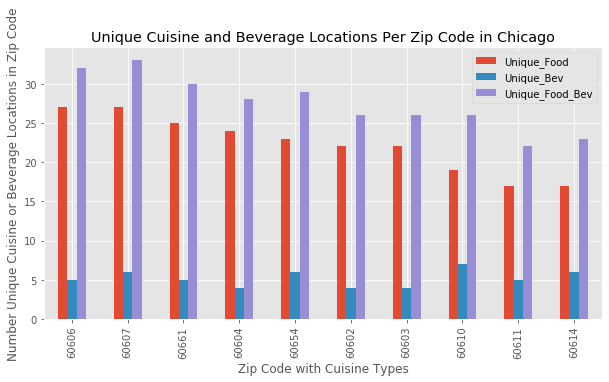

In [68]:

Top10_Unique.plot(kind='bar', figsize=(10, 5))

plt.title('Unique Cuisine and Beverage Locations Per Zip Code in Chicago') # add title to the plot
plt.xlabel('Zip Code with Cuisine Types') # add to x-label to the plot
plt.ylabel('Number Unique Cuisine or Beverage Locations in Zip Code') # add y-label to the plot
plt.xticklabels('Neighbourhood') #Show the x Ticks as Zip Codes instead of Index Values

plt.show()

In [51]:
#Get the mean and frequency of each group which is grouped by 'Neighbourhood' which is Zip Code in this case. The frequency will help determine what is the most common venue per zip
Top10_grouped = []
Top10_grouped = Top10Foods.groupby('Neighbourhood').mean().reset_index()
Top10_grouped

num_top_venues = 10 # Looking for the top 10 common venues

for hood in Top10_grouped['Neighbourhood']: #Looking for each Zip Code
    print("----"+hood+"----")
    temp = Top10_grouped[Top10_grouped['Neighbourhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexes\base.py:5015: RuntimeWarning: divide by zero encountered in equal
  mask = indexer == -1
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in less
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in greater_equal
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in bitwise_and
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:48: RuntimeWarning: divide by zero encountered in reduce
  return umr_all(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4408: RuntimeWarning: divide by zero encountered in greater_equal
  positive_indices

----60602----
                       venue  freq
0                Coffee Shop   7.0
1                Snack Place   3.0
2   Mediterranean Restaurant   3.0
3         Italian Restaurant   3.0
4             Sandwich Place   3.0
5                     Bakery   2.0
6                        Bar   2.0
7  Middle Eastern Restaurant   2.0
8        American Restaurant   2.0
9                 Donut Shop   2.0


----60603----


C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\series.py:2145: RuntimeWarning: divide by zero encountered in rint
  result = com.values_from_object(self).round(decimals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\series.py:2145: RuntimeWarning: divide by zero encountered in true_divide
  result = com.values_from_object(self).round(decimals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexes\base.py:5562: RuntimeWarning: divide by zero encountered in equal
  if (res == data).all():
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\numeric.py:2327: RuntimeWarning: divide by zero encountered in equal
  return bool(asarray(a1 == a2).all())
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\sorting.py:268: RuntimeWarning: divide by zero encountered in invert
  non_nans = items[~mask]
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\sorting.py:269: RuntimeWarning: divide by zero encountered in invert
  non_nan_idx = idx[~mask]
C:\Users\Reena\anac

C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1928: RuntimeWarning: divide by zero encountered in long_scalars
  wrap = curr_width + 1 > line_width and i > 0
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:205: RuntimeWarning: divide by zero encountered in less
  mask = indices < 0
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in greater_equal
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in less
  mask = (indices >= n) | (indices < 0)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\indexers.py:210: RuntimeWarning: divide by zero encountered in bitwise_or
  mask = (indices >= n) | (indices < 0

                           venue  freq
0                    Coffee Shop   7.0
1                    Snack Place   3.0
2             Italian Restaurant   3.0
3            American Restaurant   3.0
4                     Donut Shop   2.0
5  Vegetarian / Vegan Restaurant   2.0
6                         Bakery   2.0
7                    Salad Place   2.0
8                      Gastropub   2.0
9                 Sandwich Place   2.0


----60604----
                           venue  freq
0                    Coffee Shop   7.0
1                 Sandwich Place   4.0
2                   Burger Joint   3.0
3             Italian Restaurant   3.0
4                            Bar   2.0
5            American Restaurant   2.0
6               Sushi Restaurant   2.0
7  Vegetarian / Vegan Restaurant   2.0
8                    Salad Place   2.0
9      Middle Eastern Restaurant   2.0


----60606----


C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:45: RuntimeWarning: divide by zero encountered in reduce
  return umr_any(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:379: RuntimeWarning: divide by zero encountered in invert
  return ~res
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1252: RuntimeWarning: divide by zero encountered in bitwise_and
  is_float_type = lib.map_infer(vals, is_float) & notna(vals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan
  result = np.isnan(values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1375: RuntimeWarning: divide by zero encountered in invert
  imask = (~mask).ravel()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1418: RuntimeWarning: divide by zero encountered in absolute
  abs_vals = np.abs(self.values)
C:\Users

                           venue  freq
0                    Coffee Shop  10.0
1                 Sandwich Place   5.0
2                     Donut Shop   4.0
3       Mediterranean Restaurant   4.0
4            American Restaurant   4.0
5             Mexican Restaurant   3.0
6              Indian Restaurant   3.0
7                    Snack Place   3.0
8  Vegetarian / Vegan Restaurant   3.0
9                      BBQ Joint   3.0


----60607----


C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:379: RuntimeWarning: divide by zero encountered in invert
  return ~res
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1252: RuntimeWarning: divide by zero encountered in bitwise_and
  is_float_type = lib.map_infer(vals, is_float) & notna(vals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan
  result = np.isnan(values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1375: RuntimeWarning: divide by zero encountered in invert
  imask = (~mask).ravel()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1418: RuntimeWarning: divide by zero encountered in absolute
  abs_vals = np.abs(self.values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1422: RuntimeWarning: divide by zero encountered in greater
  has_large_values = (abs_vals > 1e6).any()
C:\U

                     venue  freq
0  New American Restaurant   6.0
1             Burger Joint   3.0
2             Cocktail Bar   3.0
3      Japanese Restaurant   3.0
4               Restaurant   3.0
5       Italian Restaurant   3.0
6              Coffee Shop   2.0
7               Donut Shop   2.0
8              Pizza Place   2.0
9       Chinese Restaurant   2.0


----60610----
                     venue  freq
0               Steakhouse   8.0
1                      Bar   7.0
2       Italian Restaurant   5.0
3       Seafood Restaurant   5.0
4               Restaurant   4.0
5       Mexican Restaurant   4.0
6      American Restaurant   4.0
7  New American Restaurant   4.0
8      Japanese Restaurant   2.0
9         Sushi Restaurant   2.0


----60611----


C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:226: RuntimeWarning: divide by zero encountered in equal
  if (new_blknos == -1).any():
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:48: RuntimeWarning: divide by zero encountered in reduce
  return umr_all(a, axis, dtype, out, keepdims)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in less
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in greater_equal
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in bitwise_and
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4408: RuntimeWarning: divide by zero encountered in greater_equal
  pos

                 venue  freq
0  American Restaurant   7.0
1          Coffee Shop   5.0
2           Restaurant   4.0
3   Italian Restaurant   4.0
4           Steakhouse   3.0
5                  Bar   3.0
6            Hotel Bar   3.0
7   Seafood Restaurant   2.0
8    French Restaurant   2.0
9         Cocktail Bar   2.0


----60614----
                venue  freq
0                 Bar   7.0
1    Sushi Restaurant   4.0
2         Pizza Place   3.0
3  Italian Restaurant   3.0
4          Donut Shop   2.0
5        Burger Joint   2.0
6         Coffee Shop   2.0
7  Mexican Restaurant   2.0
8      Sandwich Place   2.0
9          Sports Bar   1.0


----60654----


C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1252: RuntimeWarning: divide by zero encountered in bitwise_and
  is_float_type = lib.map_infer(vals, is_float) & notna(vals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan
  result = np.isnan(values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1375: RuntimeWarning: divide by zero encountered in invert
  imask = (~mask).ravel()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1418: RuntimeWarning: divide by zero encountered in absolute
  abs_vals = np.abs(self.values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1422: RuntimeWarning: divide by zero encountered in greater
  has_large_values = (abs_vals > 1e6).any()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\io\formats\format.py:1424: RuntimeWarning: divide by zero encountered in less
  (abs_vals < 10 ** (

                     venue  freq
0               Steakhouse   9.0
1       Italian Restaurant   8.0
2                      Bar   6.0
3       Mexican Restaurant   4.0
4               Restaurant   4.0
5  New American Restaurant   4.0
6             Cocktail Bar   3.0
7         Sushi Restaurant   3.0
8              Coffee Shop   3.0
9      American Restaurant   3.0


----60661----
                     venue  freq
0  New American Restaurant   7.0
1                      Bar   7.0
2               Restaurant   6.0
3             Cocktail Bar   5.0
4              Coffee Shop   4.0
5      Japanese Restaurant   3.0
6         Sushi Restaurant   3.0
7           Sandwich Place   3.0
8       Italian Restaurant   3.0
9                  Brewery   3.0




C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in less
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in greater_equal
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4400: RuntimeWarning: divide by zero encountered in bitwise_and
  inside_bounds = (obj < N) & (obj >= -N)
C:\Users\Reena\anaconda3\lib\site-packages\numpy\lib\function_base.py:4408: RuntimeWarning: divide by zero encountered in greater_equal
  positive_indices = obj >= 0
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\series.py:2145: RuntimeWarning: divide by zero encountered in multiply
  result = com.values_from_object(self).round(decimals)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\series.py:2145: RuntimeWarning: divide by zero encountered in rint
  resul

In [52]:
#We want to now create a table that has the top 10 most common cuisine or beverage types per Zip Code (based on the frequencies).
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [61]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
Top10neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
Top10neighborhoods_venues_sorted['Neighborhood'] = Top10_grouped['Neighbourhood']

for ind in np.arange(Top10_grouped.shape[0]):
    Top10neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(Top10_grouped.iloc[ind, :], num_top_venues)

Top10neighborhoods_venues_sorted

C:\Users\Reena\anaconda3\lib\site-packages\ipykernel_launcher.py:9: RuntimeWarning: divide by zero encountered in long_scalars
  if __name__ == '__main__':
C:\Users\Reena\anaconda3\lib\site-packages\ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in long_scalars
  # This is added back by InteractiveShellApp.init_path()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\dtypes\missing.py:262: RuntimeWarning: divide by zero encountered in isnan
  result = np.isnan(values)
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:226: RuntimeWarning: divide by zero encountered in equal
  if (new_blknos == -1).any():
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\series.py:2959: RuntimeWarning: divide by zero encountered in invert
  good = ~bad
C:\Users\Reena\anaconda3\lib\site-packages\numpy\core\_methods.py:38: RuntimeWarning: divide by zero encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
C:\Users\R

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,60602,Coffee Shop,Snack Place,Sandwich Place,Mediterranean Restaurant,Italian Restaurant,Bar,Middle Eastern Restaurant,Gastropub,Salad Place,Donut Shop
1,60603,Coffee Shop,Snack Place,American Restaurant,Italian Restaurant,Sandwich Place,Salad Place,Gastropub,Bakery,Donut Shop,Vegetarian / Vegan Restaurant
2,60604,Coffee Shop,Sandwich Place,Burger Joint,Italian Restaurant,Vegetarian / Vegan Restaurant,Middle Eastern Restaurant,American Restaurant,Pizza Place,Bar,Sushi Restaurant
3,60606,Coffee Shop,Sandwich Place,Mediterranean Restaurant,Donut Shop,American Restaurant,Vegetarian / Vegan Restaurant,BBQ Joint,Indian Restaurant,Mexican Restaurant,Snack Place
4,60607,New American Restaurant,Restaurant,Burger Joint,Italian Restaurant,Japanese Restaurant,Cocktail Bar,Mediterranean Restaurant,Sandwich Place,Chinese Restaurant,Brewery
5,60610,Steakhouse,Bar,Seafood Restaurant,Italian Restaurant,American Restaurant,Mexican Restaurant,New American Restaurant,Restaurant,Sushi Restaurant,Pizza Place
6,60611,American Restaurant,Coffee Shop,Restaurant,Italian Restaurant,Bar,Hotel Bar,Steakhouse,Cocktail Bar,French Restaurant,Burger Joint
7,60614,Bar,Sushi Restaurant,Italian Restaurant,Pizza Place,Burger Joint,Donut Shop,Mexican Restaurant,Coffee Shop,Sandwich Place,Wings Joint
8,60654,Steakhouse,Italian Restaurant,Bar,Restaurant,New American Restaurant,Mexican Restaurant,Coffee Shop,Sushi Restaurant,Cocktail Bar,American Restaurant
9,60661,New American Restaurant,Bar,Restaurant,Cocktail Bar,Coffee Shop,BBQ Joint,Sandwich Place,Brewery,Sushi Restaurant,Mediterranean Restaurant


In [64]:
#Create new Data Frames
Top_merged = Top10neighborhoods_venues_sorted

# merge the top 10 common venues from above cell with the table that was used to calculate the unique food, bev and both values
Top_merged = Top_merged.join(Top10_Unique.set_index('Neighbourhood'), on='Neighborhood')

Top_merged.sort_values('Unique_Food', ascending = False)


C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:226: RuntimeWarning: divide by zero encountered in equal
  if (new_blknos == -1).any():
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:1006: RuntimeWarning: divide by zero encountered in negative
  ref_loc_offset = -is_deleted.cumsum()
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:1027: RuntimeWarning: divide by zero encountered in add
  blk.mgr_locs = bml.add(ref_loc_offset[bml.indexer])
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:1027: RuntimeWarning: divide by zero encountered in less
  blk.mgr_locs = bml.add(ref_loc_offset[bml.indexer])
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\internals\managers.py:1030: RuntimeWarning: divide by zero encountered in invert
  self.axes[0] = self.items[~is_deleted]
C:\Users\Reena\anaconda3\lib\site-packages\pandas\core\reshape\merge.py:1917: RuntimeWarning: divide by z

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,Unique_Food,Unique_Bev,Unique_Food_Bev
3,60606,Coffee Shop,Sandwich Place,Mediterranean Restaurant,Donut Shop,American Restaurant,Vegetarian / Vegan Restaurant,BBQ Joint,Indian Restaurant,Mexican Restaurant,Snack Place,27,5,32
4,60607,New American Restaurant,Restaurant,Burger Joint,Italian Restaurant,Japanese Restaurant,Cocktail Bar,Mediterranean Restaurant,Sandwich Place,Chinese Restaurant,Brewery,27,6,33
9,60661,New American Restaurant,Bar,Restaurant,Cocktail Bar,Coffee Shop,BBQ Joint,Sandwich Place,Brewery,Sushi Restaurant,Mediterranean Restaurant,25,5,30
2,60604,Coffee Shop,Sandwich Place,Burger Joint,Italian Restaurant,Vegetarian / Vegan Restaurant,Middle Eastern Restaurant,American Restaurant,Pizza Place,Bar,Sushi Restaurant,24,4,28
8,60654,Steakhouse,Italian Restaurant,Bar,Restaurant,New American Restaurant,Mexican Restaurant,Coffee Shop,Sushi Restaurant,Cocktail Bar,American Restaurant,23,6,29
0,60602,Coffee Shop,Snack Place,Sandwich Place,Mediterranean Restaurant,Italian Restaurant,Bar,Middle Eastern Restaurant,Gastropub,Salad Place,Donut Shop,22,4,26
1,60603,Coffee Shop,Snack Place,American Restaurant,Italian Restaurant,Sandwich Place,Salad Place,Gastropub,Bakery,Donut Shop,Vegetarian / Vegan Restaurant,22,4,26
5,60610,Steakhouse,Bar,Seafood Restaurant,Italian Restaurant,American Restaurant,Mexican Restaurant,New American Restaurant,Restaurant,Sushi Restaurant,Pizza Place,19,7,26
6,60611,American Restaurant,Coffee Shop,Restaurant,Italian Restaurant,Bar,Hotel Bar,Steakhouse,Cocktail Bar,French Restaurant,Burger Joint,17,5,22
7,60614,Bar,Sushi Restaurant,Italian Restaurant,Pizza Place,Burger Joint,Donut Shop,Mexican Restaurant,Coffee Shop,Sandwich Place,Wings Joint,17,6,23
